# Problem Statement
In this assignment, you would face real world data of applications and bureau as shared by Home Credit, to practice the end-to-end process of model development in Credit Risk for Banks, Financial Institutions and NBFCs. You would build a bank’s internal end-to-end scoring mechanism, based on the application information, clubbed with the raw bureau information.
The primary objective of this study is to assist Home Credit in deciding which loan applications should be disbursed, and which should be rejected, based on the applicant’s past behaviour and application information.

Goal:
As a business analyst for Home Credit, you are supposed to first gather the information and clean it to make it usable.
The bureau information is at trade level, each individual trade level information is provided. You need to apply ‘Feature Engineering’ techniques to roll up the information at applicant level, and thereby create manual features for model building.
Build a classification model to differentiate applicants between approves and rejects.

As a business analyst, you would want to find answers to the below questions for the bank:
How to leverage trade level information for Credit Bureaus by aggregating trade level information to applicant level in order to capture their payment behaviour?
Which application or payment behaviour factors significantly influence borrower’s behaviour on any new disbursed loan?
After identifying these factors, how to leverage them in the form of a model which can be used for decisioning?
Once the model is built, how to translate the model output into strategies and business insights for the bank?
With this, we move to our next section where we gather a better understanding of the data and set expectations of what is needed from this assignment.

# Proposed Solution 

We will follow following Major Steps in solving this problem :
1.  Data Exploration of Application Data 
2.  Data Quality Checks and Corrections : Null, Duplicate , missing values and imputation or drop
3.  EDA - Application Data Features ( Univariate / Bivariate - Numerical /Categorical data analysis)
4.  Data Exploration of Bureau Data & Data Quality 
5.  Merging of Application data and  Bureau data 
6.  Feature Engineering - Bureau Data ( Extracting Manual Feautures )
7.  Feature Selection using F-Score 
8.  Data Pre-processing for Machine Learning Model Building ( Train/Test split and Standard Scaler )
9. Classification Model Building and Model Evaluation along side :
    - LogisticRegression 
    - LogisticRegression with Hyper Parameter Tuning 
    - RandomForestClassifier for Binary Classification with Hyper Parameter Tuning 
    - Light Gradient Descent Boosting with Hyperparamer tuning 
10. Conclusion / Recommendation as a Business Analysis to Finance Institutions based on application and Bureau trade level informtion. 


### Importing the libraries.

In [2]:
#import the useful libraries.
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
#import the warnings and display size.
import warnings
warnings.filterwarnings("ignore")
pd.set_option("display.max_rows", None,"display.max_columns", None)

Matplotlib created a temporary config/cache directory at /var/folders/1w/2qdpts8s11zg34dptvw7qpx40000gn/T/matplotlib-8c4p1x8p because the default path (/Users/renukaupadhaya/.matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


###  Loading Data and Exploring Data  - Application Data


In [3]:
df = pd.read_csv("applications_base.csv")

In [4]:
# Reading first five rows
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

****Checking Structure of the Data****

In [5]:
# Dataframe dimensions
df.shape

(307511, 122)

In [6]:
# Checkig the datatypes
df.dtypes

SK_ID_CURR                        int64
TARGET                            int64
NAME_CONTRACT_TYPE               object
CODE_GENDER                      object
FLAG_OWN_CAR                     object
FLAG_OWN_REALTY                  object
CNT_CHILDREN                      int64
AMT_INCOME_TOTAL                float64
AMT_CREDIT                      float64
AMT_ANNUITY                     float64
AMT_GOODS_PRICE                 float64
NAME_TYPE_SUITE                  object
NAME_INCOME_TYPE                 object
NAME_EDUCATION_TYPE              object
NAME_FAMILY_STATUS               object
NAME_HOUSING_TYPE                object
REGION_POPULATION_RELATIVE      float64
DAYS_BIRTH                        int64
DAYS_EMPLOYED                     int64
DAYS_REGISTRATION               float64
DAYS_ID_PUBLISH                   int64
OWN_CAR_AGE                     float64
FLAG_MOBIL                        int64
FLAG_EMP_PHONE                    int64
FLAG_WORK_PHONE                   int64


In [7]:
# Info of the Data Frame
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [8]:
# Numeric statistical details of the data frame
df.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502130,5.143927e-01,0.510853,0.11744,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,0.042553,0.074490,0.145193,0.222315,0.228058,0.064958,0.105645,0.105975,0.008076,0.027022,0.117850,0.087955,0.97

### Data Quality Analysis and Data Correction - Application Data

**Null Values Analysis in Each Columns**

In [9]:
df.isnull().sum()

SK_ID_CURR                           0
TARGET                               0
NAME_CONTRACT_TYPE                   0
CODE_GENDER                          0
FLAG_OWN_CAR                         0
FLAG_OWN_REALTY                      0
CNT_CHILDREN                         0
AMT_INCOME_TOTAL                     0
AMT_CREDIT                           0
AMT_ANNUITY                         12
AMT_GOODS_PRICE                    278
NAME_TYPE_SUITE                   1292
NAME_INCOME_TYPE                     0
NAME_EDUCATION_TYPE                  0
NAME_FAMILY_STATUS                   0
NAME_HOUSING_TYPE                    0
REGION_POPULATION_RELATIVE           0
DAYS_BIRTH                           0
DAYS_EMPLOYED                        0
DAYS_REGISTRATION                    0
DAYS_ID_PUBLISH                      0
OWN_CAR_AGE                     202929
FLAG_MOBIL                           0
FLAG_EMP_PHONE                       0
FLAG_WORK_PHONE                      0
FLAG_CONT_MOBILE         

**We can see that there there are many columns which are >= 40% missing values. We can drop such columns**

In [10]:
# List of Columns/NA counts where Null values are more than 40%
null_column = df.isnull().sum().sort_values(ascending=False)
null_column = null_column[null_column.values > (0.40 * len(df))]

In [11]:
# Copy of original data
app_df = df.copy()

In [12]:
# Dropping columns with null values more than 40%
app_df.drop(null_column.index, axis=1, inplace=True)

In [13]:
# Print the shape of the DataFrame after dropping columns
print("DataFrame after dropping columns with null values more than 40%:", app_df.shape)

# Displaying modified DataFrame
app_df.head()

DataFrame after dropping columns with null values more than 40%: (307511, 73)


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


**Dropped the columns  which have the columns greater than 40%.**

 ### Find the remaining columns having Top 10 null value %  < 40 in the  Data

In [14]:
# Calculate the percentage of null values for each column
null_value_columns = app_df.isnull().sum() / len(app_df) * 100.00

# Sort and select the top 10 columns with the highest percentage of null values
null_value_columns_10 = null_value_columns.sort_values(ascending=False).head(10)

# Print the top 10 columns with the highest percentage of null values
print("Top 10 Columns with Highest % of Null Values:")
print(null_value_columns_10)


Top 10 Columns with Highest % of Null Values:
OCCUPATION_TYPE               31.345545
EXT_SOURCE_3                  19.825307
AMT_REQ_CREDIT_BUREAU_YEAR    13.501631
AMT_REQ_CREDIT_BUREAU_QRT     13.501631
AMT_REQ_CREDIT_BUREAU_MON     13.501631
AMT_REQ_CREDIT_BUREAU_WEEK    13.501631
AMT_REQ_CREDIT_BUREAU_DAY     13.501631
AMT_REQ_CREDIT_BUREAU_HOUR    13.501631
NAME_TYPE_SUITE                0.420148
OBS_30_CNT_SOCIAL_CIRCLE       0.332021
dtype: float64


**After dropping some columns,still have null columns.OCCUPATION_TYPE has <40% nulls, but still significant We can fill missing values with mean/median/mode, but sometimes its better to leave them for analysis integrity**

**Exploring the OCCUPATION_TYPE column to identify appropriate imputation strategies**

In [15]:
print(app_df["OCCUPATION_TYPE"].value_counts()); print(app_df["OCCUPATION_TYPE"].mode()[0])

OCCUPATION_TYPE
Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: count, dtype: int64
Laborers


**We will impute OCCUPATION_TYPE with mode, which is the value Laborers beacaues it is most frequently occurring
value in the column.**

In [16]:
app_df["OCCUPATION_TYPE"] = app_df["OCCUPATION_TYPE"].fillna(app_df["OCCUPATION_TYPE"].mode()[0]); app_df["OCCUPATION_TYPE"].value_counts()

OCCUPATION_TYPE
Laborers                 151577
Sales staff               32102
Core staff                27570
Managers                  21371
Drivers                   18603
High skill tech staff     11380
Accountants                9813
Medicine staff             8537
Security staff             6721
Cooking staff              5946
Cleaning staff             4653
Private service staff      2652
Low-skill Laborers         2093
Waiters/barmen staff       1348
Secretaries                1305
Realty agents               751
HR staff                    563
IT staff                    526
Name: count, dtype: int64

##### Checking if there is any correlation between EXT_SOURCE_3, EXT_SOURCE_2  with  TARGET using heatmap

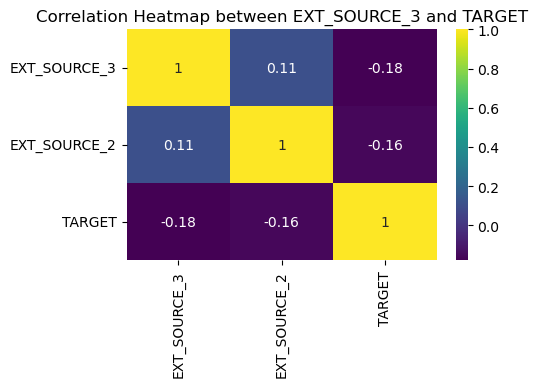

In [17]:
correlation_matrix = app_df[['EXT_SOURCE_3','EXT_SOURCE_2', 'TARGET']].corr()
plt.figure(figsize=(5, 3))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis')
plt.title('Correlation Heatmap between EXT_SOURCE_3 and TARGET')
plt.show()

### Since there's weak correlation, dropping EXT_SOURCE_3 and EXT_SOURCE_2 columns.

In [18]:
app_df = app_df.drop(["EXT_SOURCE_2","EXT_SOURCE_3"], axis=1)
app_df.shape

(307511, 71)

**Analysing AMT_ANNUITY column to find out a suitable imputation techniques**

**We can impute the missing values for the column  which is less than or equal to 13% ,we need to find out which is the best suitable method for imputaion for these columns using the help of boxplot or statistics analysis.**

- AMT_REQ_CREDIT_BUREAU_YEAR
- AMT_REQ_CREDIT_BUREAU_QRT
- AMT_REQ_CREDIT_BUREAU_MON
- AMT_REQ_CREDIT_BUREAU_WEEK
- AMT_REQ_CREDIT_BUREAU_DAY
- AMT_REQ_CREDIT_BUREAU_HOUR

In [19]:
# Checking the datatypes.
col =['AMT_REQ_CREDIT_BUREAU_YEAR','AMT_REQ_CREDIT_BUREAU_QRT','AMT_REQ_CREDIT_BUREAU_MON','AMT_REQ_CREDIT_BUREAU_WEEK','AMT_REQ_CREDIT_BUREAU_DAY','AMT_REQ_CREDIT_BUREAU_HOUR']
app_df[col].dtypes

AMT_REQ_CREDIT_BUREAU_YEAR    float64
AMT_REQ_CREDIT_BUREAU_QRT     float64
AMT_REQ_CREDIT_BUREAU_MON     float64
AMT_REQ_CREDIT_BUREAU_WEEK    float64
AMT_REQ_CREDIT_BUREAU_DAY     float64
AMT_REQ_CREDIT_BUREAU_HOUR    float64
dtype: object

In [20]:
columns_to_impute = ["AMT_REQ_CREDIT_BUREAU_YEAR", "AMT_REQ_CREDIT_BUREAU_QRT","AMT_REQ_CREDIT_BUREAU_MON","AMT_REQ_CREDIT_BUREAU_WEEK","AMT_REQ_CREDIT_BUREAU_DAY","AMT_REQ_CREDIT_BUREAU_HOUR"]

for column in columns_to_impute:
    print(f"Statistics of the {column} column:")
    print(app_df[column].describe())
    app_df[column].fillna(app_df[column].median(), inplace=True)


Statistics of the AMT_REQ_CREDIT_BUREAU_YEAR column:
count    265992.000000
mean          1.899974
std           1.869295
min           0.000000
25%           0.000000
50%           1.000000
75%           3.000000
max          25.000000
Name: AMT_REQ_CREDIT_BUREAU_YEAR, dtype: float64
Statistics of the AMT_REQ_CREDIT_BUREAU_QRT column:
count    265992.000000
mean          0.265474
std           0.794056
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         261.000000
Name: AMT_REQ_CREDIT_BUREAU_QRT, dtype: float64
Statistics of the AMT_REQ_CREDIT_BUREAU_MON column:
count    265992.000000
mean          0.267395
std           0.916002
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          27.000000
Name: AMT_REQ_CREDIT_BUREAU_MON, dtype: float64
Statistics of the AMT_REQ_CREDIT_BUREAU_WEEK column:
count    265992.000000
mean          0.034362
std           0.204685
min           0.000000
2

- For the column AMT_REQ_CREDIT_BUREAU_YEAR we can impute the missing value with the median,which is the value 1.
- For the column AMT_REQ_CREDIT_BUREAU_QRT we can impute the missing value with the median which is 0
- For the column AMT_REQ_CREDIT_BUREAU_MON we can impute the missing value with the median which is 0
- For the column AMT_REQ_CREDIT_BUREAU_WEEK we can impute the missing value with the median which is 0
- For the column AMT_REQ_CREDIT_BUREAU_DAY we can impute the missing value with the median which is 0
- For the column AMT_REQ_CREDIT_BUREAU_HOUR we can impute the missing value with the median which is 0

##### Identifying imputation for OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,column

In [21]:
columns_to_impute = ["OBS_30_CNT_SOCIAL_CIRCLE", "DEF_30_CNT_SOCIAL_CIRCLE","OBS_60_CNT_SOCIAL_CIRCLE","DEF_60_CNT_SOCIAL_CIRCLE"]

for column in columns_to_impute:
    print(f"Statistics of the {column} column:")
    print(app_df[column].describe())
    app_df[column].fillna(app_df[column].median(), inplace=True)


Statistics of the OBS_30_CNT_SOCIAL_CIRCLE column:
count    306490.000000
mean          1.422245
std           2.400989
min           0.000000
25%           0.000000
50%           0.000000
75%           2.000000
max         348.000000
Name: OBS_30_CNT_SOCIAL_CIRCLE, dtype: float64
Statistics of the DEF_30_CNT_SOCIAL_CIRCLE column:
count    306490.000000
mean          0.143421
std           0.446698
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          34.000000
Name: DEF_30_CNT_SOCIAL_CIRCLE, dtype: float64
Statistics of the OBS_60_CNT_SOCIAL_CIRCLE column:
count    306490.000000
mean          1.405292
std           2.379803
min           0.000000
25%           0.000000
50%           0.000000
75%           2.000000
max         344.000000
Name: OBS_60_CNT_SOCIAL_CIRCLE, dtype: float64
Statistics of the DEF_60_CNT_SOCIAL_CIRCLE column:
count    306490.000000
mean          0.100049
std           0.362291
min           0.000000
25%        

### Analysing 'AMT_GOODS_PRICE' Column

In [22]:
percentile_95 = app_df['AMT_GOODS_PRICE'].quantile(0.95)
percentile_99 = app_df['AMT_GOODS_PRICE'].quantile(0.99)
max_value = app_df['AMT_GOODS_PRICE'].max()
std_dev = app_df['AMT_GOODS_PRICE'].std()
median_value = app_df['AMT_GOODS_PRICE'].median()

Result = pd.DataFrame({
     'statistic': ['95th percentile', '99th percentile', 'max_value', 'Standard_Dev', 'median'],
     'values': [percentile_95, percentile_99, max_value, std_dev, median_value]
 })

print(Result)

         statistic        values
0  95th percentile  1.305000e+06
1  99th percentile  1.800000e+06
2        max_value  4.050000e+06
3     Standard_Dev  3.694465e+05
4           median  4.500000e+05


**Here there is a difference between the 99th values and the maximum value, we can conclude that there are outliers in the AMT_GOODS_PRICE column and secondly there is higher deviation in values since standard deviation is large. so, here we can impute the missing values with the median, which is the value '450000'**

In [23]:
app_df["AMT_GOODS_PRICE"].fillna(app_df["AMT_GOODS_PRICE"].median(), inplace=True)
print(app_df['AMT_GOODS_PRICE'].isnull().sum())

0


### Analysing 'AMT_ANNUITY' Column

In [24]:
percentile_95 = app_df['AMT_ANNUITY'].quantile(0.95)
percentile_99 = app_df['AMT_ANNUITY'].quantile(0.99)
max_value = app_df['AMT_ANNUITY'].max()
std_dev = app_df['AMT_ANNUITY'].std()
median_value = app_df['AMT_ANNUITY'].median()

Result = pd.DataFrame({
     'statistic': ['95th percentile', '99th percentile', 'max_value', 'Standard_Dev', 'median'],
     'values': [percentile_95, percentile_99, max_value, std_dev, median_value]
 })

print(Result)

         statistic         values
0  95th percentile   53325.000000
1  99th percentile   70006.500000
2        max_value  258025.500000
3     Standard_Dev   14493.737315
4           median   24903.000000


**Here there is a huge difference between the 95th & 99th values and the maximum value, we can conclude that
there are outliers in the AMT_ANNUITY columnIn such conditions  i will use median to impute the missing value.**

In [25]:
app_df["AMT_ANNUITY"].fillna(app_df["AMT_ANNUITY"].median(), inplace=True)
print(app_df['AMT_ANNUITY'].isnull().sum())

0


### Analysing 'CNT_FAM_MEMBERS' Column

In [26]:
percentile_95 = app_df['CNT_FAM_MEMBERS'].quantile(0.95)
percentile_99 = app_df['CNT_FAM_MEMBERS'].quantile(0.99)
max_value = app_df['CNT_FAM_MEMBERS'].max()
std_dev = app_df['CNT_FAM_MEMBERS'].std()
median_value = app_df['CNT_FAM_MEMBERS'].median()

Result = pd.DataFrame({
     'statistic': ['95th percentile', '99th percentile', 'max_value', 'Standard_Dev', 'median'],
     'values': [percentile_95, percentile_99, max_value, std_dev, median_value]
 })

print(Result)

         statistic     values
0  95th percentile   4.000000
1  99th percentile   5.000000
2        max_value  20.000000
3     Standard_Dev   0.910682
4           median   2.000000


**The maximum value of 20 is verymuch higher than the percentiles, which might indicate the presence of outliers we can conclude that there are outliers in the CNT_FAM_MEMBERS column and secondly there is no as such deviation in these values, therefore we can replace the null values with the median.**

In [27]:
app_df["CNT_FAM_MEMBERS"].fillna(app_df["CNT_FAM_MEMBERS"].median(), inplace=True)
print(app_df['CNT_FAM_MEMBERS'].isnull().sum())

0


### Analysing 'DAYS_LAST_PHONE_CHANGE' Column

In [28]:
percentile_95 = app_df['DAYS_LAST_PHONE_CHANGE'].quantile(0.95)
percentile_99 = app_df['DAYS_LAST_PHONE_CHANGE'].quantile(0.99)
max_value = app_df['DAYS_LAST_PHONE_CHANGE'].max()
std_dev = app_df['DAYS_LAST_PHONE_CHANGE'].std()
median_value = app_df['DAYS_LAST_PHONE_CHANGE'].median()

Result = pd.DataFrame({
     'statistic': ['95th percentile', '99th percentile', 'max_value', 'Standard_Dev', 'median'],
     'values': [percentile_95, percentile_99, max_value, std_dev, median_value]
 })

print(Result)

         statistic      values
0  95th percentile    0.000000
1  99th percentile    0.000000
2        max_value    0.000000
3     Standard_Dev  826.808487
4           median -757.000000


**The median value of -757.000000 is unusual,**

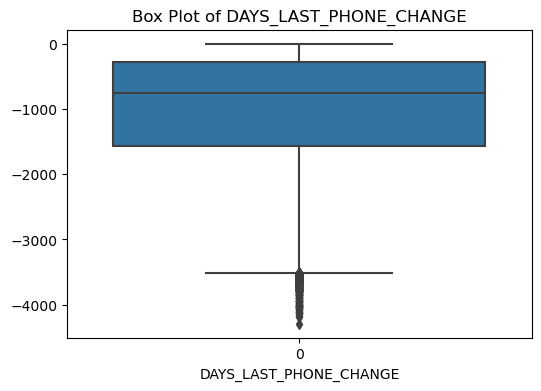

In [29]:
plt.figure(figsize=(6, 4))
sns.boxplot(app_df['DAYS_LAST_PHONE_CHANGE'])
plt.title('Box Plot of DAYS_LAST_PHONE_CHANGE')
plt.xlabel('DAYS_LAST_PHONE_CHANGE')
plt.show()

**Inference: Extreme outliers that are negatively impacting the median So, we cannot  impute the null values with median.**

In [30]:
app_df = app_df.drop(["DAYS_LAST_PHONE_CHANGE",], axis=1)

In [31]:
#Checking the shape of the updated Dataset.
app_df.shape

(307511, 70)

### Analysing NAME_TYPE_SUITE column

In [32]:
# missing values in NAME_TYPE_SUITE column
app_df['NAME_TYPE_SUITE'].isnull().sum()

1292

In [33]:
app_df['NAME_TYPE_SUITE'].isnull().mean()

0.004201475719567756

In [34]:
# Value count in NAME_TYPE_SUITE variable
app_df['NAME_TYPE_SUITE'].value_counts(dropna=False)

NAME_TYPE_SUITE
Unaccompanied      248526
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
NaN                  1292
Other_A               866
Group of people       271
Name: count, dtype: int64

**We can impute the values for the column 'NAME_TYPE_SUITE' with mode, which is value 'Unaccompanied'.**

In [35]:
app_df["NAME_TYPE_SUITE"] = app_df["NAME_TYPE_SUITE"].fillna(app_df["NAME_TYPE_SUITE"].mode()[0]); app_df["NAME_TYPE_SUITE"].value_counts()


NAME_TYPE_SUITE
Unaccompanied      249818
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271
Name: count, dtype: int64

### Finding errors in Data types.

**Performing imputation on a column containing negative day values by converting them to their absolute values.**

In [36]:
print(app_df['DAYS_BIRTH'].unique())
print(app_df['DAYS_EMPLOYED'].unique())
print(app_df['DAYS_REGISTRATION'].unique())
print(app_df['DAYS_ID_PUBLISH'].unique())

[ -9461 -16765 -19046 ...  -7951  -7857 -25061]
[  -637  -1188   -225 ... -12971 -11084  -8694]
[ -3648.  -1186.  -4260. ... -16396. -14558. -14798.]
[-2120  -291 -2531 ... -6194 -5854 -6211]


In [37]:
# The columns starting with 'DAYS'
columns = ['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH']
columns

['DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH']

In [38]:
# Applying abs() function to columns to convert the negative values to positive.
app_df[columns]= abs(app_df[columns])

In [39]:
# checking the changes in dataset.
print(app_df['DAYS_BIRTH'].unique())
print(app_df['DAYS_EMPLOYED'].unique())
print(app_df['DAYS_REGISTRATION'].unique())
print(app_df['DAYS_ID_PUBLISH'].unique())

[ 9461 16765 19046 ...  7951  7857 25061]
[  637  1188   225 ... 12971 11084  8694]
[ 3648.  1186.  4260. ... 16396. 14558. 14798.]
[2120  291 2531 ... 6194 5854 6211]


**Lets check distribution of CODE_GENDER**

In [40]:
# Checking value counts for CODE_GENDER
app_df.CODE_GENDER.value_counts()

CODE_GENDER
F      202448
M      105059
XNA         4
Name: count, dtype: int64

**We can impute the missing values for the column CODE_GENDER with mode which is value 'F'**

In [41]:
# Replacing XNA value with F
app_df.loc[app_df.CODE_GENDER == 'XNA','CODE_GENDER'] = 'F'
app_df.CODE_GENDER.value_counts()

CODE_GENDER
F    202452
M    105059
Name: count, dtype: int64

**Lets analyse the column ORGANIZATION_TYPE**

In [42]:
# Checking the value counts of organization _type
# app_df.ORGANIZATION_TYPE.value_counts()
print("Organization Types (Top 5):")
print(app_df['ORGANIZATION_TYPE'].value_counts().head())


Organization Types (Top 5):
ORGANIZATION_TYPE
Business Entity Type 3    67992
XNA                       55374
Self-employed             38412
Other                     16683
Medicine                  11193
Name: count, dtype: int64


In [43]:
#Replacing XNA with NaN
app_df['ORGANIZATION_TYPE'].replace('XNA', np.NaN, inplace=True)
app_df['ORGANIZATION_TYPE'].fillna(app_df['ORGANIZATION_TYPE'].mode().iloc[0], inplace=True)
print(app_df['ORGANIZATION_TYPE'].value_counts(dropna=False).head())

ORGANIZATION_TYPE
Business Entity Type 3    123366
Self-employed              38412
Other                      16683
Medicine                   11193
Business Entity Type 2     10553
Name: count, dtype: int64


In [44]:
null_values = app_df.isnull().sum()/len(app_df)*100
null_values.sort_values(ascending = False).head(15)

SK_ID_CURR                  0.0
FLAG_DOCUMENT_2             0.0
FLAG_DOCUMENT_8             0.0
FLAG_DOCUMENT_7             0.0
FLAG_DOCUMENT_6             0.0
FLAG_DOCUMENT_5             0.0
FLAG_DOCUMENT_4             0.0
FLAG_DOCUMENT_3             0.0
DEF_60_CNT_SOCIAL_CIRCLE    0.0
FLAG_DOCUMENT_10            0.0
OBS_60_CNT_SOCIAL_CIRCLE    0.0
DEF_30_CNT_SOCIAL_CIRCLE    0.0
OBS_30_CNT_SOCIAL_CIRCLE    0.0
ORGANIZATION_TYPE           0.0
LIVE_CITY_NOT_WORK_CITY     0.0
dtype: float64

### Identifying Outliers for Numerical columns:

**Identifying  outliers for Numerical columns: # AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY**

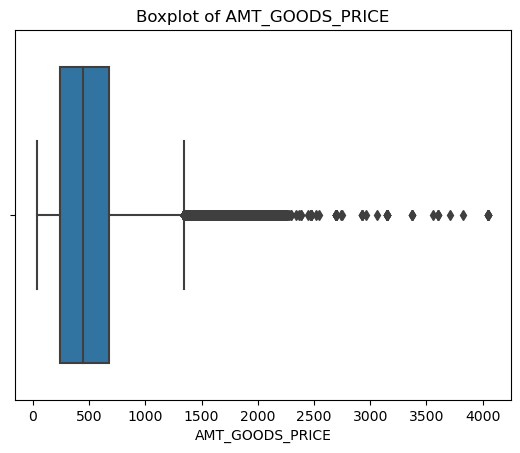

count    307511.000000
mean        538.316294
std         369.288982
min          40.500000
25%         238.500000
50%         450.000000
75%         679.500000
max        4050.000000
Name: AMT_GOODS_PRICE, dtype: float64
Percentage of outliers in AMT_GOODS_PRICE: 4.79%


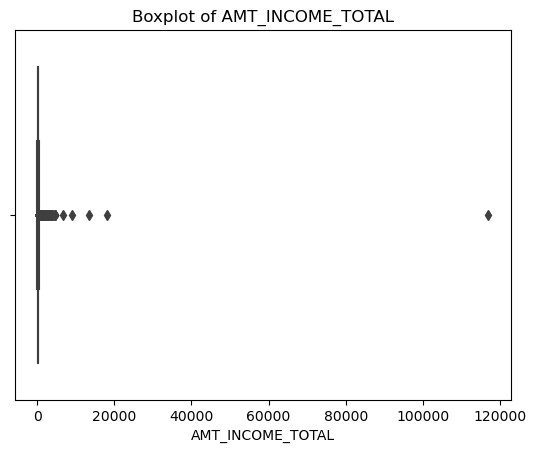

count    307511.000000
mean        168.797919
std         237.123146
min          25.650000
25%         112.500000
50%         147.150000
75%         202.500000
max      117000.000000
Name: AMT_INCOME_TOTAL, dtype: float64
Percentage of outliers in AMT_INCOME_TOTAL: 4.56%


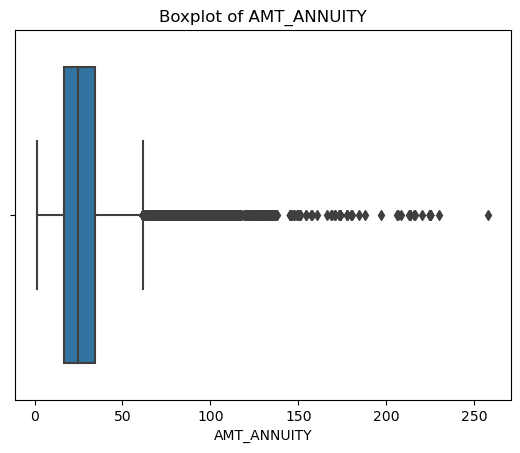

count    307511.000000
mean         27.108488
std          14.493461
min           1.615500
25%          16.524000
50%          24.903000
75%          34.596000
max         258.025500
Name: AMT_ANNUITY, dtype: float64
Percentage of outliers in AMT_ANNUITY: 2.44%


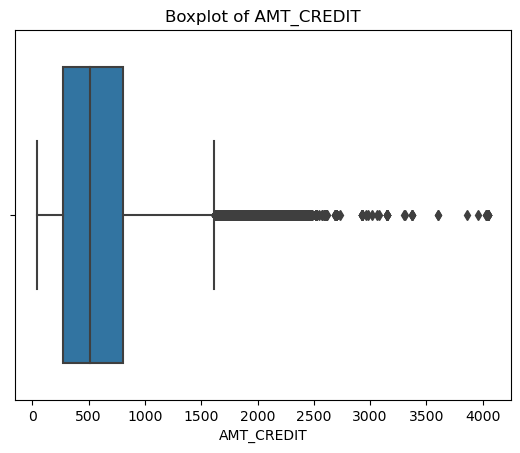

count    307511.000000
mean        599.026000
std         402.490777
min          45.000000
25%         270.000000
50%         513.531000
75%         808.650000
max        4050.000000
Name: AMT_CREDIT, dtype: float64
Percentage of outliers in AMT_CREDIT: 2.13%


In [45]:
# List of numerical var
numerical_var = ['AMT_GOODS_PRICE', 'AMT_INCOME_TOTAL', 'AMT_ANNUITY', 'AMT_CREDIT']

# Loop through each numerical variable
for var in numerical_var:
    # Deviding by 1000 for the ease of read and converting value in ('000s')
    sns.boxplot(x=app_df[var]/1000.0)
    plt.title(f'Boxplot of {var}')
    plt.show()

    # Checking column statistics
    var_des = (app_df[var]/1000.0).describe()
    print(var_des)

    # Maximum Value for boxplot:
    quantile_var = (app_df[var]/1000.0).quantile(0.75)-(app_df[var]/1000.0).quantile(0.25)
    upper_l_quantile_var = (app_df[var]/1000.0).quantile(0.75) + quantile_var * 1.5

    # Percentage of outliers
    percentage_outliers = round(100.0 * len(app_df[(app_df[var]/1000.0) > upper_l_quantile_var]) / len(app_df), 2)
    print(f'Percentage of outliers in {var}: {percentage_outliers}%')

**Inference:**
 - From the box plot we can see that there are outliers in AMT_GOODS_PRICE,which is approximatley 4.79%
 - From the box plot we can see that there are outliers in AMT_INCOME_TOTAL,which is approximatley 4.56%
 - From the box plot we can see that there are outliers in AMT_ANNUITY,which is approximatley 2.44%
 - From the box plot we can see that there are outliers in AMT_CREDIT,which is approximatley 2.13%

### Binning of continuous Variable

In [46]:
app_df.head(2)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648.0,2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,2.0,2.0,2.0,2.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186.0,291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,1.0,0.0,1.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


**Binning of Continuous variables for "DAYS_BIRTH" to simplify the data**

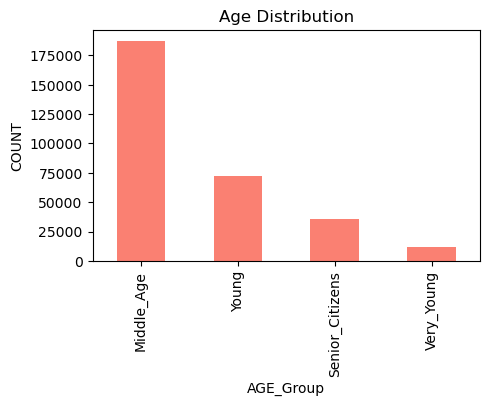

In [47]:
# Converting 'DAYS_BIRTH' to years
# DAYS_BIRTH column can be binned as ['Very_Young','Young', 'Middle_Age', 'Senior_Citizens'].
app_df['DAYS_BIRTH'] = app_df['DAYS_BIRTH'] / 365.0
app_df['AGE_Group'] = pd.cut(x=app_df['DAYS_BIRTH'], bins=[0, 25, 35, 60, 100], labels=['Very_Young', 'Young', 'Middle_Age', 'Senior_Citizens'])
# Count the values in each group
age_distribution = app_df['AGE_Group'].value_counts()
plt.figure(figsize=(5, 3))
age_distribution.plot(kind='bar', color='salmon')
plt.xlabel("AGE_Group")
plt.ylabel("COUNT")
plt.title("Age Distribution")
plt.show()

**Binning of Continuous variables for "AMT_INCOME_TOTAL" to simplify the data**

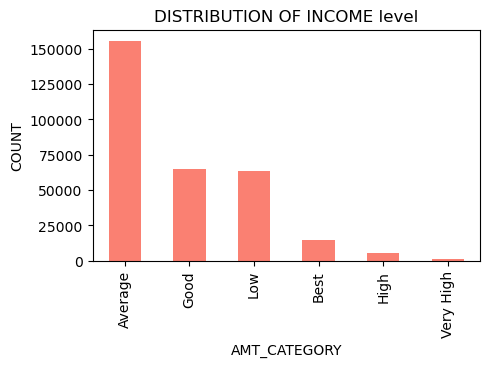

In [48]:
#AMT_INCOME_TOTAL column can be binned as 'Low','Average', 'Good', 'Best' ,'High', 'Very High'
app_df["AMT_CATEGORY"] = pd.cut(app_df["AMT_INCOME_TOTAL"], bins=[0,100000, 200000, 300000, 400000, 500000, 600000], labels=['Low','Average', 'Good', 'Best' ,'High', 'Very High'])
income_distribution = app_df["AMT_CATEGORY"].value_counts()
plt.figure(figsize=(5,3))
income_distribution.plot(kind="bar", color="salmon")
plt.xlabel("AMT_CATEGORY")
plt.ylabel("COUNT")
plt.title("DISTRIBUTION OF INCOME level")
plt.show()


In [49]:
app_df.shape

(307511, 72)

**Lets check some of the columns which is irrevelent for the analysis, first we need to do the corelation matrix and find out the relation between with 'Target' variable if it doesnot have any relation , we can drop that column from the dataset**

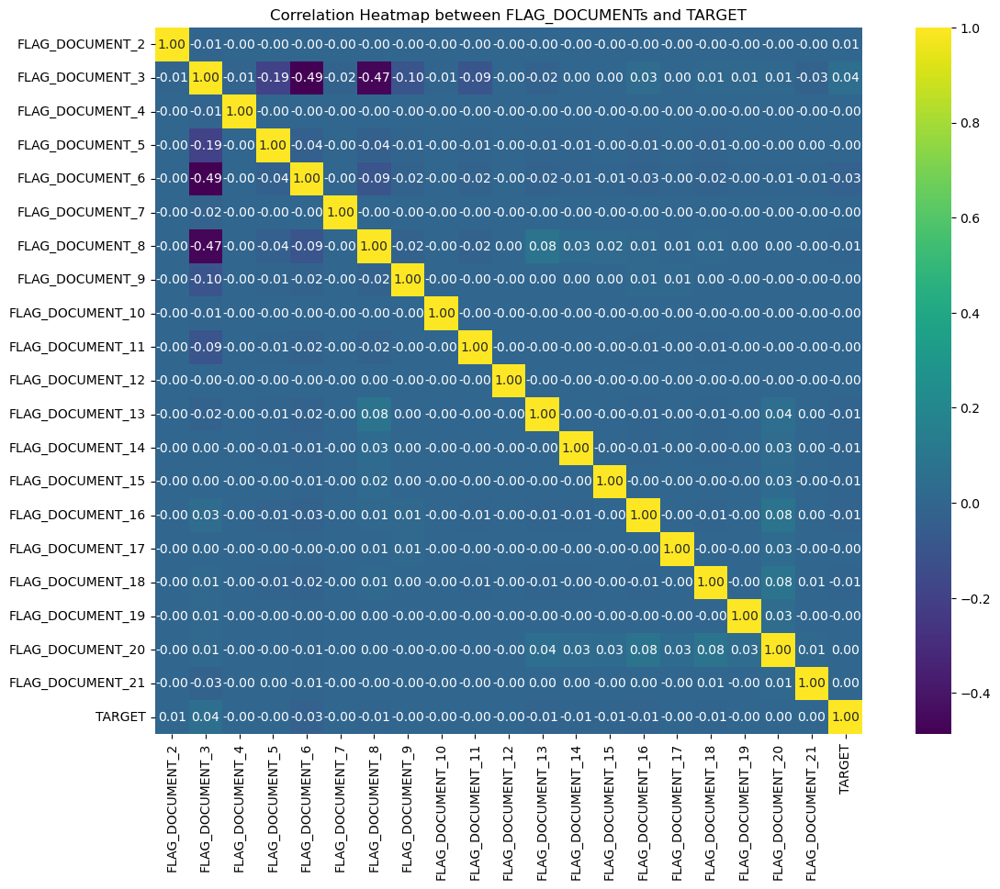

In [50]:
correlation_matrix = app_df[['FLAG_DOCUMENT_2','FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_4','FLAG_DOCUMENT_5','FLAG_DOCUMENT_6',
                            'FLAG_DOCUMENT_7','FLAG_DOCUMENT_8','FLAG_DOCUMENT_9','FLAG_DOCUMENT_10','FLAG_DOCUMENT_11',
                            'FLAG_DOCUMENT_12','FLAG_DOCUMENT_13','FLAG_DOCUMENT_14','FLAG_DOCUMENT_15','FLAG_DOCUMENT_16',
                            'FLAG_DOCUMENT_17','FLAG_DOCUMENT_18','FLAG_DOCUMENT_19','FLAG_DOCUMENT_20','FLAG_DOCUMENT_21','TARGET']].corr()

plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f", square=True)
plt.title('Correlation Heatmap between FLAG_DOCUMENTs and TARGET')

plt.show()

In [51]:
correlation_matrix.corr().head()

,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,TARGET
FLAG_DOCUMENT_2,1.000000,-0.002103,-0.047793,-0.030994,-0.007312,-0.047105,-0.021420,-0.041911,-0.048502,-0.039992,-0.049300,-0.052087,-0.050765,-0.050730,-0.053503,-0.050847,-0.051854,-0.050846,-0.066885,-0.048803,-0.035682
FLAG_DOCUMENT_3,-0.002103,1.000000,-0.008479,-0.274279,-0.668169,-0.019891,-0.639678,-0.133556,0.001668,-0.127403,0.009959,-0.041922,0.011730,0.009705,0.076982,0.017073,0.035278,0.031878,0.034084,-0.026318,0.101169
FLAG_DOCUMENT_4,-0.047793,-0.008479,1.000000,-0.030268,-0.006549,-0.046299,-0.020625,-0.041086,-0.047692,-0.039213,-0.048502,-0.051425,-0.050174,-0.050052,-0.053210,-0.050093,-0.051456,-0.050176,-0.066013,-0.048028,-0.051964
FLAG_DOCUMENT_5,-0.030994,-0.274279,-0.030268,1.000000,0.014033,-0.029436,0.002750,-0.022549,-0.031076,-0.021920,-0.032477,-0.046343,-0.046918,-0.041894,-0.064183,-0.037528,-0.055188,-0.040513,-0.052846,-0.025256,-0.037677
FLAG_DOCUMENT_6,-0.007312,-0.668169,-0.006549,0.014033,1.000000,-0.005665,0.029617,0.002452,-0.007405,0.002636,-0.009568,-0.037562,-0.037563,-0.028411,-0.072783,-0.018206,-0.055943,-0.021334,-0.031341,-0.007663,-0.078185


**We can conclude from the above heatmap plot that the 'FLAG_DOCUMENT' column does not show any significant relationship with the 'TARGET' variable. Therefore, i will drop these coloumn.**

In [52]:
col_to_drop=['FLAG_DOCUMENT_2','FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_4','FLAG_DOCUMENT_5','FLAG_DOCUMENT_6',
            'FLAG_DOCUMENT_7','FLAG_DOCUMENT_8','FLAG_DOCUMENT_9','FLAG_DOCUMENT_10','FLAG_DOCUMENT_11',
            'FLAG_DOCUMENT_12','FLAG_DOCUMENT_13','FLAG_DOCUMENT_14','FLAG_DOCUMENT_15','FLAG_DOCUMENT_16',
            'FLAG_DOCUMENT_17','FLAG_DOCUMENT_18','FLAG_DOCUMENT_19','FLAG_DOCUMENT_20','FLAG_DOCUMENT_21']
app_df.drop(columns=col_to_drop, inplace=True)

print(app_df.shape)

(307511, 52)


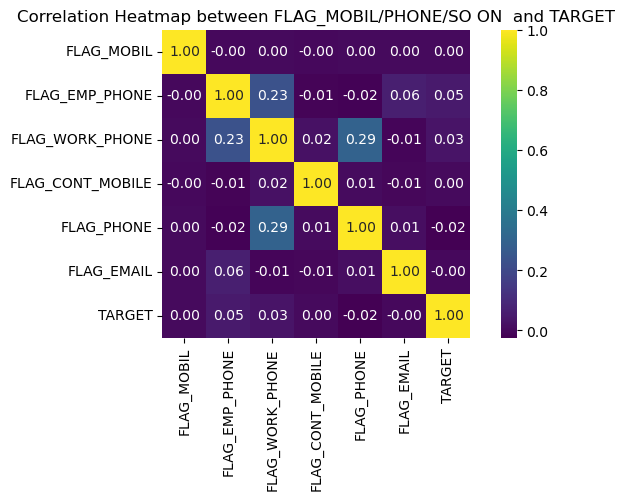

In [53]:
correlation_matrix1 = app_df[['FLAG_MOBIL','FLAG_EMP_PHONE', 'FLAG_WORK_PHONE','FLAG_CONT_MOBILE','FLAG_PHONE',
                            'FLAG_EMAIL','TARGET']].corr()
plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix1, annot=True, cmap='viridis', fmt=".2f", square=True)
plt.title('Correlation Heatmap between FLAG_MOBIL/PHONE/SO ON  and TARGET')
plt.show()

Same as Before We can conclude from the above heatmap plot that the column does not show any significant relationship with the 'TARGET' variable. Therefore, it may be advisable to consider dropping this column for a more effective analysis approach.

In [54]:
colo_to_drop=['FLAG_MOBIL','FLAG_EMP_PHONE', 'FLAG_WORK_PHONE','FLAG_CONT_MOBILE','FLAG_PHONE','FLAG_EMAIL']
app_df.drop(columns=colo_to_drop, inplace=True)

print(app_df.shape)

(307511, 46)


In [55]:
app_df.head(2)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,AGE_Group,AMT_CATEGORY
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,25.920548,637,3648.0,2120,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,2.0,2.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,Young,Good
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,45.931507,1188,1186.0,291,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Middle_Age,Good


#  Parameters Identification for Target Variable - Application Data

**First Let's check Imbalance of data based on Target Variable**

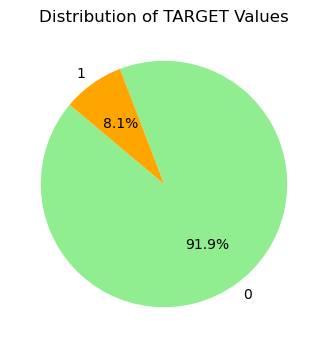

In [56]:
value_counts_target = app_df['TARGET'].value_counts(normalize=True)
plt.figure(figsize=(4, 4))
plt.pie(value_counts_target, labels=value_counts_target.index, autopct='%1.1f%%', startangle=140, colors=['lightgreen', 'orange'])
plt.title('Distribution of TARGET Values')
plt.show()

**Inference: The data is highly imbalanced, where 91.9% of 'TARGET' variable is 0 (other cases/able to pay loan) and 8.1% of 'TARGET' variable is 1(difficulty in repaying the loan).**

### Creating two data sets - one for each Target = 1 and Target = 0

**Creating Target_0_df, people paid loan**

In [57]:
target_0_df = app_df.query('TARGET == 0')

In [58]:
target_0_df.shape

(282686, 46)

**Creating Target_1_df, client with payment difficulties**

In [59]:
# Creating Dataframe of the defaulters
target_1_df = app_df.query('TARGET == 1')

In [60]:
target_1_df.shape

(24825, 46)

**Any column which is either of object type or have less than 40 values is considered categorical. Remaining columns of type float or int will be considered numerical**

In [61]:
app_df.isnull().sum()

SK_ID_CURR                        0
TARGET                            0
NAME_CONTRACT_TYPE                0
CODE_GENDER                       0
FLAG_OWN_CAR                      0
FLAG_OWN_REALTY                   0
CNT_CHILDREN                      0
AMT_INCOME_TOTAL                  0
AMT_CREDIT                        0
AMT_ANNUITY                       0
AMT_GOODS_PRICE                   0
NAME_TYPE_SUITE                   0
NAME_INCOME_TYPE                  0
NAME_EDUCATION_TYPE               0
NAME_FAMILY_STATUS                0
NAME_HOUSING_TYPE                 0
REGION_POPULATION_RELATIVE        0
DAYS_BIRTH                        0
DAYS_EMPLOYED                     0
DAYS_REGISTRATION                 0
DAYS_ID_PUBLISH                   0
OCCUPATION_TYPE                   0
CNT_FAM_MEMBERS                   0
REGION_RATING_CLIENT              0
REGION_RATING_CLIENT_W_CITY       0
WEEKDAY_APPR_PROCESS_START        0
HOUR_APPR_PROCESS_START           0
REG_REGION_NOT_LIVE_REGION  

In [62]:
# Convert 'AMT_CATEGORY' column to object type
app_df['AMT_CATEGORY'] = app_df['AMT_CATEGORY'].astype('object')

# Fill missing values in 'AMT_CATEGORY' column with 'Unknown'
app_df['AMT_CATEGORY'].fillna('Unknown', inplace=True)

# Convert 'AMT_CATEGORY' column back to categorical type
app_df['AMT_CATEGORY'] = app_df['AMT_CATEGORY'].astype('category')

# Verify the count of missing values after filling
print("Count of missing values in 'AMT_CATEGORY':", app_df['AMT_CATEGORY'].isnull().sum())


Count of missing values in 'AMT_CATEGORY': 0


In [63]:
app_df.isnull().sum()

SK_ID_CURR                     0
TARGET                         0
NAME_CONTRACT_TYPE             0
CODE_GENDER                    0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
CNT_CHILDREN                   0
AMT_INCOME_TOTAL               0
AMT_CREDIT                     0
AMT_ANNUITY                    0
AMT_GOODS_PRICE                0
NAME_TYPE_SUITE                0
NAME_INCOME_TYPE               0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
REGION_POPULATION_RELATIVE     0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_REGISTRATION              0
DAYS_ID_PUBLISH                0
OCCUPATION_TYPE                0
CNT_FAM_MEMBERS                0
REGION_RATING_CLIENT           0
REGION_RATING_CLIENT_W_CITY    0
WEEKDAY_APPR_PROCESS_START     0
HOUR_APPR_PROCESS_START        0
REG_REGION_NOT_LIVE_REGION     0
REG_REGION_NOT_WORK_REGION     0
LIVE_REGION_NOT_WORK_REGION    0
REG_CITY_N

In [64]:
# Fill missing values in 'DAYS_EMPLOYED' column with median
median_days_employed = app_df['DAYS_EMPLOYED'].median()
app_df['DAYS_EMPLOYED'].fillna(median_days_employed, inplace=True)

# Verify the count of missing values after filling
print("Count of missing values in 'DAYS_EMPLOYED':", app_df['DAYS_EMPLOYED'].isnull().sum())


Count of missing values in 'DAYS_EMPLOYED': 0


In [65]:
app_df.isnull().sum()

SK_ID_CURR                     0
TARGET                         0
NAME_CONTRACT_TYPE             0
CODE_GENDER                    0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
CNT_CHILDREN                   0
AMT_INCOME_TOTAL               0
AMT_CREDIT                     0
AMT_ANNUITY                    0
AMT_GOODS_PRICE                0
NAME_TYPE_SUITE                0
NAME_INCOME_TYPE               0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
REGION_POPULATION_RELATIVE     0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_REGISTRATION              0
DAYS_ID_PUBLISH                0
OCCUPATION_TYPE                0
CNT_FAM_MEMBERS                0
REGION_RATING_CLIENT           0
REGION_RATING_CLIENT_W_CITY    0
WEEKDAY_APPR_PROCESS_START     0
HOUR_APPR_PROCESS_START        0
REG_REGION_NOT_LIVE_REGION     0
REG_REGION_NOT_WORK_REGION     0
LIVE_REGION_NOT_WORK_REGION    0
REG_CITY_N

###  Distribution of data Check

#### Distribution of what types of loan available

<Figure size 1000x600 with 0 Axes>

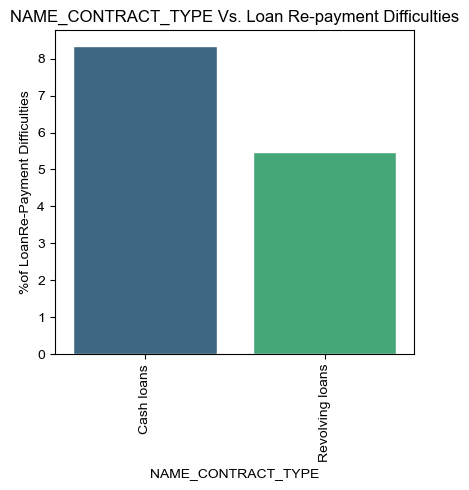

In [66]:
# Common function to plot distribution of columns with respect to TARGET = 1
def plot_bars(column_name="NAME_CONTRACT_TYPE", fig_size =0):
    plt.figure(figsize=(10, 6))
    if fig_size == 0:
        plt.figure(figsize=(10, 4))
    total_counts = app_df.groupby(by=[column_name, "TARGET"]).size().unstack(fill_value=0).sum(axis=1)
    target_counts = (app_df.groupby([column_name, "TARGET"]).size() / total_counts*100.0).unstack(fill_value=0).sort_index()

    plt.figure(figsize=(8, 5))
    if fig_size == 0:
        plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 2)
    sns.set_style("whitegrid")
    ax2 = sns.barplot(x=target_counts.index, y=target_counts[1],  palette="viridis")
    ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90)
    ax2.set(xlabel=column_name, ylabel='%of LoanRe-Payment Difficulties', title=f'{column_name} Vs. Loan Re-payment Difficulties')
    plt.tight_layout()
    plt.show()

plot_bars("NAME_CONTRACT_TYPE" , 1)


**Many people are willing to take cash loan than revolving loan**

**Distribution of 'NAME_EDUCATION_TYPE'**

<Figure size 1000x600 with 0 Axes>

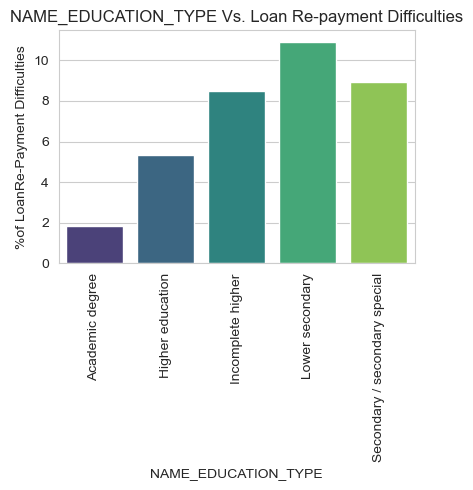

In [67]:
# BarPlots for NAME_EDUCATION_TYPE
plot_bars("NAME_EDUCATION_TYPE" , 1)

**Inference:People with Academic Degree are more likely to repay the loan than other categories.**

**Distribution of 'NAME_TYPE_SUITE'**

<Figure size 1000x600 with 0 Axes>

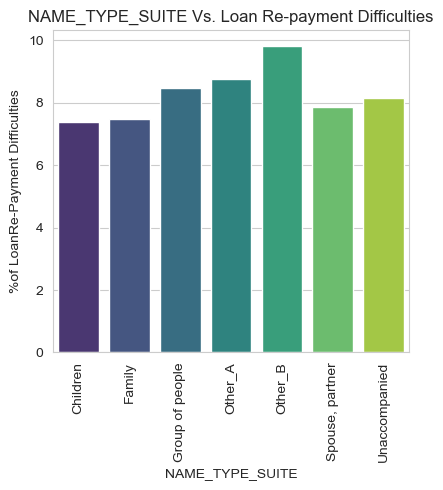

In [68]:
#BarPlots for NAME_TYPE_SUITE
plot_bars("NAME_TYPE_SUITE" , 1)

**Distribution of 'NAME_INCOME_TYPE'**

<Figure size 1000x600 with 0 Axes>

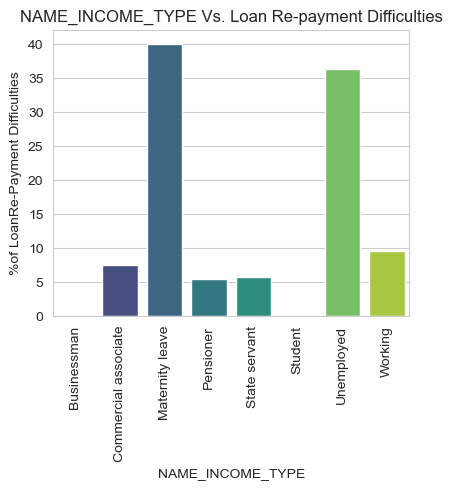

In [69]:
# BarPlots for NAME_INCOME_TYPE
plot_bars("NAME_INCOME_TYPE" , 1)

**Inference: From the above plots All the Students and Businessman are repaying loan.**

**Distribution of 'NAME_FAMILY_STATUS'**

<Figure size 1000x600 with 0 Axes>

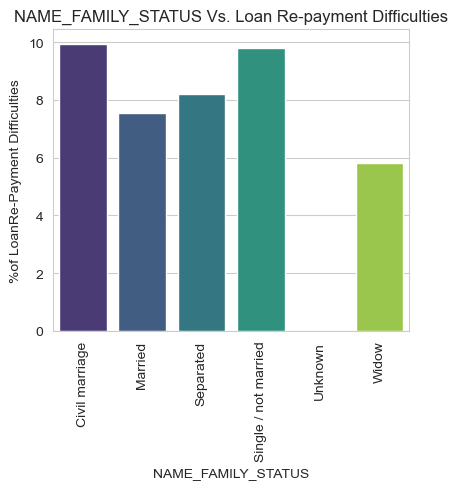

In [70]:
# BarPlots for NAME_FAMILY_STATUS
plot_bars("NAME_FAMILY_STATUS" , 1)

**Inference: Widows are more likely to repay the loan when compared to appliants with the other family statuses.**

**Distribution of 'NAME_HOUSING_TYPE'**

<Figure size 1000x600 with 0 Axes>

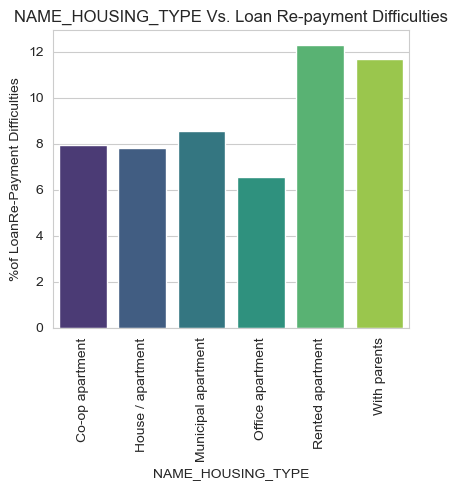

In [71]:
# BarPlots for NAME_HOUSING_TYPE
plot_bars("NAME_HOUSING_TYPE" , 1)

**Inference: office apartment are more likely to repay the loan when compared to appliants with the other family statuses.**

#### Label Encoding For Converting Categorical to Numerical 


In [72]:
app_df.select_dtypes(include=['object','category']).columns

Index(['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE',
       'WEEKDAY_APPR_PROCESS_START', 'ORGANIZATION_TYPE', 'AGE_Group',
       'AMT_CATEGORY'],
      dtype='object')

In [73]:
from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer
# Generic function to encode the categorical variable

def label_encoding(app_df=app_df):
    non_numeric_dtypes = ['object', 'category', 'bool', 'string']
  # Select categorical columns
    categorical_cols = app_df.select_dtypes(include=non_numeric_dtypes).columns


    print(f"Categorical Variables before Label Encoding: {categorical_cols}")

    # Initialize LabelEncoder
    label_encoder = LabelEncoder()
    # Encode categorical columns
    for col in categorical_cols:
        app_df[col] = label_encoder.fit_transform(app_df[col])

    categorical_cols = app_df.select_dtypes(include=non_numeric_dtypes).columns

    print(f"Categorical Variables after Label Encoding: {categorical_cols}")
    return app_df
app_df_encoded = label_encoding(app_df)


Categorical Variables before Label Encoding: Index(['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE',
       'WEEKDAY_APPR_PROCESS_START', 'ORGANIZATION_TYPE', 'AGE_Group',
       'AMT_CATEGORY'],
      dtype='object')
Categorical Variables after Label Encoding: Index([], dtype='object')


In [74]:
app_df_encoded['TARGET'].value_counts()

TARGET
0    282686
1     24825
Name: count, dtype: int64

##### Distribution of 'AMT_INCOME_TOTAL'

In [75]:
import plotly.graph_objects as go
app_df = app_df_encoded.copy()
# Filter data for 'AMT_INCOME_TOTAL' less than 2000000 and for Target == 0
filtered_income_target_0 = app_df[(app_df['AMT_INCOME_TOTAL'] < 2000000) & (app_df['TARGET'] == 0)]['AMT_INCOME_TOTAL']

# Filter data for 'AMT_INCOME_TOTAL' less than 2000000 and for Target == 1
filtered_income_target_1 = app_df[(app_df['AMT_INCOME_TOTAL'] < 2000000) & (app_df['TARGET'] == 1)]['AMT_INCOME_TOTAL']

# Create histogram trace for Target == 0
histogram_trace_target_0 = go.Histogram(x=filtered_income_target_0, nbinsx=100, name='TARGET 0')

# Create histogram trace for Target == 1
histogram_trace_target_1 = go.Histogram(x=filtered_income_target_1, nbinsx=100, name='TARGET 1')

# Create layout
layout = go.Layout(
    title='Distribution of AMT_INCOME_TOTAL based on Target',
    xaxis=dict(title='Total Income'),
    yaxis=dict(title='Count of applicants')
)

# Create figure
fig = go.Figure(data=[histogram_trace_target_0, histogram_trace_target_1], layout=layout)

# Display the plot
fig.show()

**Inferences:People with high income(>1000000) are likely to repay the loan.**

#### Distribution of 'AMT_CREDIT'

In [76]:
import plotly.graph_objects as go

# Filter the data based on the 'TARGET' variable
target_0 = app_df[app_df['TARGET'] == 0]['AMT_CREDIT']
target_1 = app_df[app_df['TARGET'] == 1]['AMT_CREDIT']

# Create histogram traces for each target category
trace_target_0 = go.Histogram(x=target_0, name='Target 0', opacity=0.7)
trace_target_1 = go.Histogram(x=target_1, name='Target 1', opacity=0.7)

# Create layout for the plot
layout = go.Layout(
    title='Distribution of AMT_CREDIT by Target Variable',
    xaxis=dict(title='Credit Amount'),
    yaxis=dict(title='Count of Applicants'),
    barmode='overlay',  # Overlay histograms for better comparison
    bargap=0.1,  # Gap between bars
    bargroupgap=0.1,  # Gap between groups of bars
)

# Create figure object and add histogram traces and layout
fig = go.Figure(data=[trace_target_0, trace_target_1], layout=layout)

# Show the plot
fig.show()


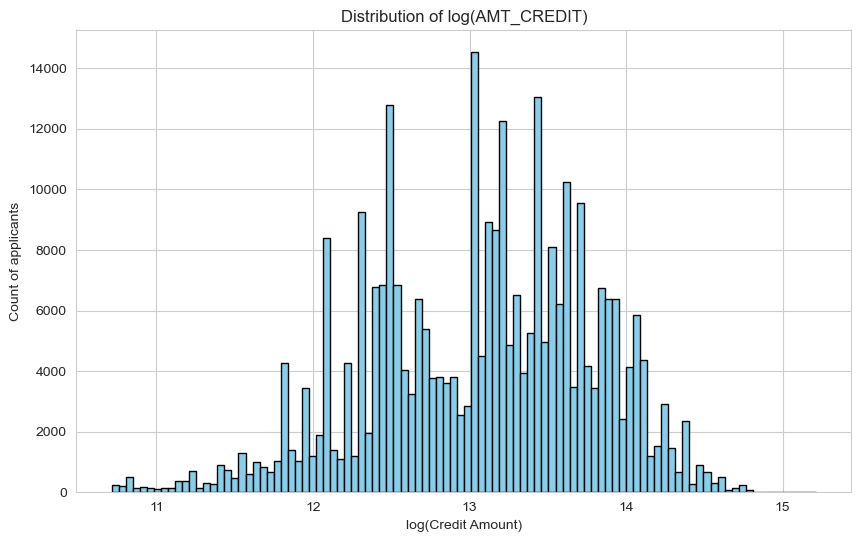

In [77]:
# Applying log transformation to 'AMT_CREDIT' column
log_amt_credit = np.log(app_df['AMT_CREDIT'])
# Ploting histogram using matplotlib
plt.figure(figsize=(10, 6))
plt.hist(log_amt_credit, bins=100, color='skyblue', edgecolor='black')
plt.xlabel('log(Credit Amount)')
plt.ylabel('Count of applicants')
plt.title('Distribution of log(AMT_CREDIT)')
plt.show()

**People who are taking credit for large amount are very likely to repay the loan.**

**Distribution of 'DAYS_BIRTH'**

In [78]:
import plotly.express as px

# Assuming 'application' is your DataFrame containing loan data
age_years = df['DAYS_BIRTH'] / (-365)  # Convert days to years

# Create a histogram with Plotly Express
fig = px.histogram(app_df, x=age_years, nbins=50,
                   title='Distribution of Clients Age',
                   labels={'x': 'Age', 'y': 'Count of type of applicants in %'},
                   template='plotly_dark',
                   color='TARGET',
                   color_discrete_sequence=['#636EFA', '#EF553B'])

# Show the plot
fig.show()


**Inference: From the above plot when we compare the two target types, we see that the clients who have difficulty in payment are relatively younger and most of them lie at around  30's.**


**Distribution of 'DAYS_EMPLOYED'**

count    307511.000000
mean      67724.742149
std      139443.751806
min           0.000000
25%         933.000000
50%        2219.000000
75%        5707.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64


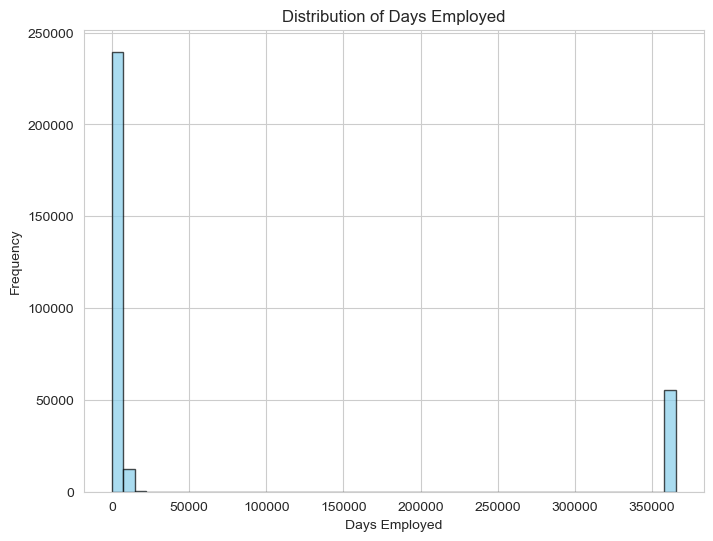

In [79]:
print(app_df['DAYS_EMPLOYED'].describe())
plt.figure(figsize=(8, 6))
plt.hist(app_df['DAYS_EMPLOYED'], bins=50, color='skyblue', edgecolor='black', alpha=0.7)
plt.xlabel('Days Employed')
plt.ylabel('Frequency')
plt.title('Distribution of Days Employed')
plt.show()

**Inferences:Individuals employed for less than two years are less likely to repay loans.**

### Bivariate Analysis OF NUMERICAL TO NUMERICAL Variable

Text(0.5, 1.0, 'Correlation Heatmap between NUMERICAL TO NUMERICAL by Target = 0')

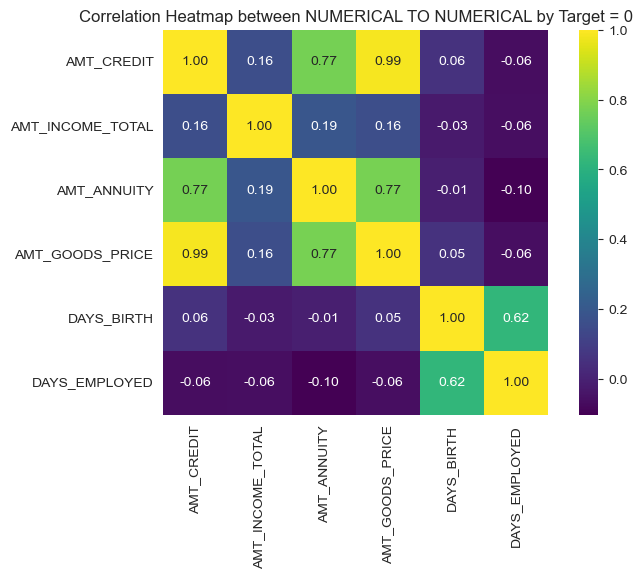

In [80]:
app_df0 = app_df[ app_df ['TARGET'] == 0 ]
matrix_num_num = app_df[['AMT_CREDIT','AMT_INCOME_TOTAL', 'AMT_ANNUITY','AMT_GOODS_PRICE','DAYS_BIRTH','DAYS_EMPLOYED',]].corr()
plt.figure(figsize=(8, 5))
sns.heatmap(matrix_num_num, annot=True, cmap='viridis', fmt=".2f", square=True)
plt.title(f'Correlation Heatmap between NUMERICAL TO NUMERICAL by Target = 0')

### Feature Engineering of Application_base Data

In [81]:
# Representing Credit Income Percentage
app_df['CREDIT_INCOME_PERCENTAGE'] = app_df['AMT_CREDIT'] / app_df['AMT_INCOME_TOTAL']
print(app_df[['AMT_CREDIT', 'AMT_INCOME_TOTAL', 'CREDIT_INCOME_PERCENTAGE']].head())

   AMT_CREDIT  AMT_INCOME_TOTAL  CREDIT_INCOME_PERCENTAGE
0    406597.5          202500.0                  2.007889
1   1293502.5          270000.0                  4.790750
2    135000.0           67500.0                  2.000000
3    312682.5          135000.0                  2.316167
4    513000.0          121500.0                  4.222222


In [82]:
# Represent Annuity Income percentage
app_df['ANNUITY_INCOME_PERCENTAGE'] = app_df['AMT_ANNUITY'] / app_df['AMT_INCOME_TOTAL']
print(app_df[['AMT_ANNUITY', 'AMT_INCOME_TOTAL', 'ANNUITY_INCOME_PERCENTAGE']].head())

   AMT_ANNUITY  AMT_INCOME_TOTAL  ANNUITY_INCOME_PERCENTAGE
0      24700.5          202500.0                   0.121978
1      35698.5          270000.0                   0.132217
2       6750.0           67500.0                   0.100000
3      29686.5          135000.0                   0.219900
4      21865.5          121500.0                   0.179963


In [83]:
# Represent Credit Term
app_df['CREDIT_TERM'] = app_df['AMT_CREDIT'] / app_df['AMT_ANNUITY']
print(app_df[['AMT_CREDIT', 'AMT_ANNUITY', 'CREDIT_TERM']].head())

   AMT_CREDIT  AMT_ANNUITY  CREDIT_TERM
0    406597.5      24700.5    16.461104
1   1293502.5      35698.5    36.234085
2    135000.0       6750.0    20.000000
3    312682.5      29686.5    10.532818
4    513000.0      21865.5    23.461618


In [84]:
# Represent Days Employed percentage
app_df['DAYS_EMPLOYED_PERCENTAGE'] = app_df['DAYS_EMPLOYED'] / app_df['DAYS_BIRTH']
print(app_df[['DAYS_EMPLOYED', 'DAYS_BIRTH', 'DAYS_EMPLOYED_PERCENTAGE']].head())

   DAYS_EMPLOYED  DAYS_BIRTH  DAYS_EMPLOYED_PERCENTAGE
0            637   25.920548                 24.575098
1           1188   45.931507                 25.864599
2            225   52.180822                  4.311929
3           3039   52.068493                 58.365430
4           3038   54.608219                 55.632651


In [85]:
# Shape of Application_base data
print('The shape of application_base data:', app_df.shape)

The shape of application_base data: (307511, 50)


In [86]:
app_df.isnull().sum()

SK_ID_CURR                     0
TARGET                         0
NAME_CONTRACT_TYPE             0
CODE_GENDER                    0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
CNT_CHILDREN                   0
AMT_INCOME_TOTAL               0
AMT_CREDIT                     0
AMT_ANNUITY                    0
AMT_GOODS_PRICE                0
NAME_TYPE_SUITE                0
NAME_INCOME_TYPE               0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
REGION_POPULATION_RELATIVE     0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_REGISTRATION              0
DAYS_ID_PUBLISH                0
OCCUPATION_TYPE                0
CNT_FAM_MEMBERS                0
REGION_RATING_CLIENT           0
REGION_RATING_CLIENT_W_CITY    0
WEEKDAY_APPR_PROCESS_START     0
HOUR_APPR_PROCESS_START        0
REG_REGION_NOT_LIVE_REGION     0
REG_REGION_NOT_WORK_REGION     0
LIVE_REGION_NOT_WORK_REGION    0
REG_CITY_N

## Exploring  bureau.csv - Past Loan Borrowing Behavior Data 

In [87]:
#. Loading the previous dataset.
bureau_df = pd.read_csv("bureau.csv")
bureau_df.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


In [88]:
bureau_df.shape

(1716428, 17)

In [89]:
# Numeric statistical details of the data frame
bureau_df.describe()

,SK_ID_CURR,SK_ID_BUREAU,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
count,1.716428e+06,1.716428e+06,1.716428e+06,1.716428e+06,1.610875e+06,1.082775e+06,5.919400e+05,1.716428e+06,1.716415e+06,1.458759e+06,1.124648e+06,1.716428e+06,1.716428e+06,4.896370e+05
mean,2.782149e+05,5.924434e+06,-1.142108e+03,8.181666e-01,5.105174e+02,-1.017437e+03,3.825418e+03,6.410406e-03,3.549946e+05,1.370851e+05,6.229515e+03,3.791276e+01,-5.937483e+02,1.571276e+04
std,1.029386e+05,5.322657e+05,7.951649e+02,3.654443e+01,4.994220e+03,7.140106e+02,2.060316e+05,9.622391e-02,1.149811e+06,6.774011e+05,4.503203e+04,5.937650e+03,7.207473e+02,3.258269e+05
min,1.000010e+05,5.000000e+06,-2.922000e+03,0.000000e+00,-4.206000e+04,-4.202300e+04,0.000000e+00,0.000000e+00,0.000000e+00,-4.705600e+06,-5.864061e+05,0.000000e+00,-4.194700e+04,0.000000e+00
25%,1.888668e+05,5.463954e+06,-1.666000e+03,0.000000e+00,-1.138000e+03,-1.489000e+03,0.000000e+00,0.000000e+00,5.130000e+04,0.000000e+00,0.000000e+00,0.000000e+00,-9.080000e+02,0.000000e+00
50%,2.780550e+05,5.926304e+06,-9.870000e+02,0.000000e+00,-3.300000e+02,-8.970000e+02,0.000000e+00,0.000000e+00,1.255185e+05,0.000000e+00,0.000000e+00,0.000000e+00,-3.950000e+02,0.000000e+00
75%,3.674260e+05,6.385681e+06,-4.740000e+02,0.000000e+00,4.740000e+02,-4.250000e+02,0.000000e+00,0.000000e+00,3.150000e+05,4.015350e+04,0.000000e+00,0.000000e+00,-3.300000e+01,1.350000e+04
max,4.562550e+05,6.843457e+06,0.000000e+00,2.792000e+03,3.119900e+04,0.000000e+00,1.159872e+08,9.000000e+00,5.850000e+08,1.701000e+08,4.705600e+06,3.756681e+06,3.720000e+02,1.184534e+08


In [90]:
bureau_df.isnull().sum()

SK_ID_CURR                      0
SK_ID_BUREAU                    0
CREDIT_ACTIVE                   0
CREDIT_CURRENCY                 0
DAYS_CREDIT                     0
CREDIT_DAY_OVERDUE              0
DAYS_CREDIT_ENDDATE        105553
DAYS_ENDDATE_FACT          633653
AMT_CREDIT_MAX_OVERDUE    1124488
CNT_CREDIT_PROLONG              0
AMT_CREDIT_SUM                 13
AMT_CREDIT_SUM_DEBT        257669
AMT_CREDIT_SUM_LIMIT       591780
AMT_CREDIT_SUM_OVERDUE          0
CREDIT_TYPE                     0
DAYS_CREDIT_UPDATE              0
AMT_ANNUITY               1226791
dtype: int64

### Data Quality Checks / Cleaning for Bureau data 

**Checkin the statistics of the column:DAYS_CREDIT_ENDDATE with missing values**

In [91]:
print(bureau_df['DAYS_CREDIT_ENDDATE'].describe())

count    1.610875e+06
mean     5.105174e+02
std      4.994220e+03
min     -4.206000e+04
25%     -1.138000e+03
50%     -3.300000e+02
75%      4.740000e+02
max      3.119900e+04
Name: DAYS_CREDIT_ENDDATE, dtype: float64


**Based on the statistics the distribution is skewed and there might be outliers present, there is a large difference between the mean and the median, and there is large standard deviation compared to the mean.So, median imputation is  suitable because it is robust to outliers and skewed distributions.
we can use median imputation to fill in the missing values for this column**

In [92]:
median_value = bureau_df['DAYS_CREDIT_ENDDATE'].median()
bureau_df['DAYS_CREDIT_ENDDATE'].fillna(median_value, inplace=True)

**Checkin the statistics of the column:DAYS_ENDDATE_FACT with missing values**

In [93]:
print(bureau_df['DAYS_ENDDATE_FACT'].describe())

count    1.082775e+06
mean    -1.017437e+03
std      7.140106e+02
min     -4.202300e+04
25%     -1.489000e+03
50%     -8.970000e+02
75%     -4.250000e+02
max      0.000000e+00
Name: DAYS_ENDDATE_FACT, dtype: float64


**Based on the statistics the distribution the presence of outliers can be inferred from the large standard deviation.we can use median imputation to fill in the missing values for this column**



In [94]:
median_value = bureau_df['DAYS_ENDDATE_FACT'].median()
bureau_df['DAYS_ENDDATE_FACT'].fillna(median_value, inplace=True)

**Checkin the statistics of the column:AMT_CREDIT_MAX_OVERDUE with missing values**

In [95]:
print(bureau_df['AMT_CREDIT_MAX_OVERDUE'].describe())

count    5.919400e+05
mean     3.825418e+03
std      2.060316e+05
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      1.159872e+08
Name: AMT_CREDIT_MAX_OVERDUE, dtype: float64


**Based on the statistics provided for the column the distribution seems highly skewed, with a large difference between the mean and median. The presence of outliers is evident from the extremely large maximum value compared to the mean and median.
 Median imputation might not be the most suitable choice, as it would be heavily influenced by the presence of outliers.So we will used mean imputation.**


In [96]:
mean_value = bureau_df['AMT_CREDIT_MAX_OVERDUE'].mean()
bureau_df['AMT_CREDIT_MAX_OVERDUE'].fillna(mean_value, inplace=True)

**Checkin the statistics of the column:AMT_CREDIT_SUM_DEBT with missing values**

In [97]:
print(bureau_df['AMT_CREDIT_SUM_DEBT'].describe())

count    1.458759e+06
mean     1.370851e+05
std      6.774011e+05
min     -4.705600e+06
25%      0.000000e+00
50%      0.000000e+00
75%      4.015350e+04
max      1.701000e+08
Name: AMT_CREDIT_SUM_DEBT, dtype: float64


**Based on the statistics provided for the column the distribution seems highly skewed, with a large difference between the mean and median. The presence of outliers is evident from the extremely large maximum value compared to the mean and median.
 Median imputation might not be the most suitable choice, as it would be heavily influenced by the presence of outliers.So we will used mean imputation.**

In [98]:
mean_value = bureau_df['AMT_CREDIT_SUM_DEBT'].mean()
bureau_df['AMT_CREDIT_SUM_DEBT'].fillna(mean_value, inplace=True)

**Checkin the statistics of the column:AMT_CREDIT_SUM_LIMIT with missing values**

In [99]:
print(bureau_df['AMT_CREDIT_SUM_LIMIT'].describe())

count    1.124648e+06
mean     6.229515e+03
std      4.503203e+04
min     -5.864061e+05
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      4.705600e+06
Name: AMT_CREDIT_SUM_LIMIT, dtype: float64


**Based on the statistics provided for the column the distribution seems highly skewed, with a large difference between the mean and median. The presence of outliers is evident from the extremely large maximum value compared to the mean and median.
 Median imputation might not be the most suitable choice, as it would be heavily influenced by the presence of outliers.So we will used mean imputation.**

In [100]:
mean_value = bureau_df['AMT_CREDIT_SUM_LIMIT'].mean()
bureau_df['AMT_CREDIT_SUM_LIMIT'].fillna(mean_value, inplace=True)

**Checkin the statistics of the column:AMT_ANNUITY with missing values**

In [101]:
print(bureau_df['AMT_ANNUITY'].describe())

count    4.896370e+05
mean     1.571276e+04
std      3.258269e+05
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      1.350000e+04
max      1.184534e+08
Name: AMT_ANNUITY, dtype: float64


**Based on the statistics provided for the column the distribution seems highly skewed, with a large difference between the mean and median. The presence of outliers is evident from the extremely large maximum value compared to the mean and median.
 Median imputation might not be the most suitable choice, as it would be heavily influenced by the presence of outliers.So we will used mean imputation.**

In [102]:
mean_value = bureau_df['AMT_ANNUITY'].mean()
bureau_df['AMT_ANNUITY'].fillna(mean_value, inplace=True)

**Checkin the statistics of the column:AMT_CREDIT_SUM with missing values**

In [103]:
print(bureau_df['AMT_CREDIT_SUM'].describe())

count    1.716415e+06
mean     3.549946e+05
std      1.149811e+06
min      0.000000e+00
25%      5.130000e+04
50%      1.255185e+05
75%      3.150000e+05
max      5.850000e+08
Name: AMT_CREDIT_SUM, dtype: float64


**Based on the statistics provided for the column the distribution seems highly skewed, with a large difference between the mean and median. The presence of outliers is evident from the extremely large maximum value compared to the mean and median.
 Median imputation might not be the most suitable choice, as it would be heavily influenced by the presence of outliers.So we will used mean imputation.**

In [104]:
mean_value = bureau_df['AMT_CREDIT_SUM'].mean()
bureau_df['AMT_CREDIT_SUM'].fillna(mean_value, inplace=True)

#### Checking again the null values

In [105]:
bureau_df.isnull().sum()

SK_ID_CURR                0
SK_ID_BUREAU              0
CREDIT_ACTIVE             0
CREDIT_CURRENCY           0
DAYS_CREDIT               0
CREDIT_DAY_OVERDUE        0
DAYS_CREDIT_ENDDATE       0
DAYS_ENDDATE_FACT         0
AMT_CREDIT_MAX_OVERDUE    0
CNT_CREDIT_PROLONG        0
AMT_CREDIT_SUM            0
AMT_CREDIT_SUM_DEBT       0
AMT_CREDIT_SUM_LIMIT      0
AMT_CREDIT_SUM_OVERDUE    0
CREDIT_TYPE               0
DAYS_CREDIT_UPDATE        0
AMT_ANNUITY               0
dtype: int64

In [106]:
bureau_df1= label_encoding(bureau_df)
bureau_df1.head()

Categorical Variables before Label Encoding: Index(['CREDIT_ACTIVE', 'CREDIT_CURRENCY', 'CREDIT_TYPE'], dtype='object')
Categorical Variables after Label Encoding: Index([], dtype='object')


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,2,0,-497,0,-153.0,-153.0,3825.417661,0,91323.0,0.000000,6229.51498,0.0,3,-131,15712.7577
1,215354,5714463,0,0,-208,0,1075.0,-897.0,3825.417661,0,225000.0,171342.000000,6229.51498,0.0,4,-20,15712.7577
2,215354,5714464,0,0,-203,0,528.0,-897.0,3825.417661,0,464323.5,137085.119952,6229.51498,0.0,3,-16,15712.7577
3,215354,5714465,0,0,-203,0,-330.0,-897.0,3825.417661,0,90000.0,137085.119952,6229.51498,0.0,4,-16,15712.7577
4,215354,5714466,0,0,-629,0,1197.0,-897.0,77674.500000,0,2700000.0,137085.119952,6229.51498,0.0,3,-21,15712.7577


**For analysing application_data and bureau.csv data together we will merge both the dataset on common column name 'SK_ID_CURR**

SK_ID_BUREAU is the unique identifier for the bureau table. Bureau table stores data at trade level and has a total of 17 features. SK_ID_CURR represents the applicant ID for which the particular trade is taken. The other features include credit behaviour of each of the trade. Since this data is at trade level, you would be required to apply Feature Engineering and roll these variables up at SK_ID_CURR level, so that it can be combined with the applications data for model building.


A few simple examples of features that can be created are:

‘number of trades reported in bureau’ (simply as the count of trades present for each applicant)
‘number of active trades’ and ‘number of closed trades’ based on CREDIT_ACTIVE
‘max_CREDIT_DAY_OVERDUE’ as the maximum of the ‘CREDIT_DAY_OVERDUE’
‘most frequent currency’ as the mode of the CREDIT_CURRENCY feature.
A good approach to figure out variables is to look at each of the features in the trade level data and think about what aggregation can be applied on top of each of them so that it could come out to be a good indicator to separate out good borrowers from bad borrowers.

In [107]:
app_df['TARGET'].value_counts()

TARGET
0    282686
1     24825
Name: count, dtype: int64

### Merging data - Application and Bureau data

In [108]:
app_bureau = app_df.merge(bureau_df1, on='SK_ID_CURR', how='inner')
app_bureau.shape

(1465325, 66)

### Feature Engineering of Bureau Data 

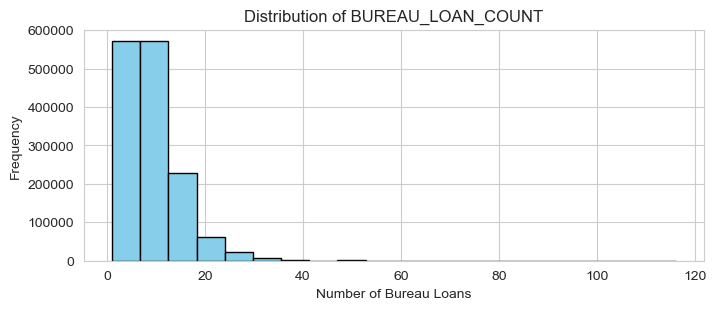

In [109]:
# Quantifying Customer Loan History
loan_count = app_bureau.groupby('SK_ID_CURR')['SK_ID_BUREAU'].count().reset_index().rename(columns={'SK_ID_BUREAU': 'BUREAU_LOAN_COUNT'})
app_bureau = app_bureau.merge(loan_count, on='SK_ID_CURR', how='left')
app_bureau['BUREAU_LOAN_COUNT'].fillna(0, inplace=True)

# Plotting the distribution of BUREAU_LOAN_COUNT
plt.figure(figsize=(8, 3))
plt.hist(app_bureau['BUREAU_LOAN_COUNT'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of BUREAU_LOAN_COUNT')
plt.xlabel('Number of Bureau Loans')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()



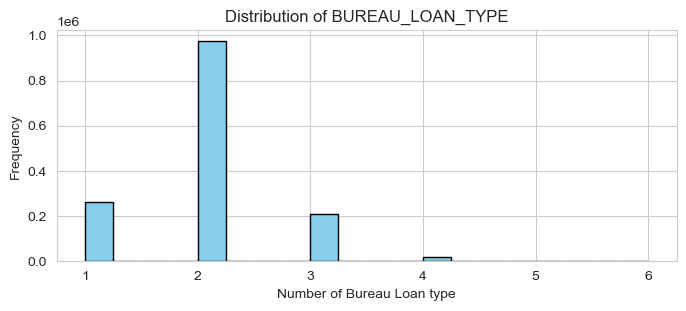

In [110]:
# Assessing the Diversity of Loan Types per Customer
loan_type_counts = app_bureau.groupby('SK_ID_CURR')['CREDIT_TYPE'].nunique().reset_index().rename(columns={'CREDIT_TYPE': 'BUREAU_LOAN_TYPE'})
app_bureau = app_bureau.merge(loan_type_counts, on='SK_ID_CURR', how='left')
app_bureau['BUREAU_LOAN_TYPE'].fillna(0, inplace=True)
# Plotting the distribution of Loan Types per Customer
plt.figure(figsize=(8, 3))
plt.hist(app_bureau['BUREAU_LOAN_TYPE'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of BUREAU_LOAN_TYPE')
plt.xlabel('Number of Bureau Loan type')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

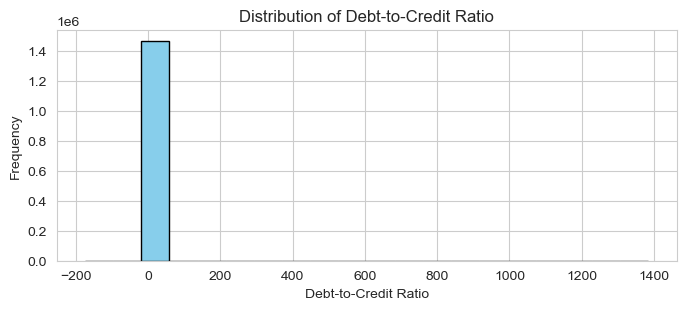

In [111]:
# Examining the Debt-to-Credit Ratio for Customers"
credit_sum_total = app_bureau.groupby('SK_ID_CURR')['AMT_CREDIT_SUM'].sum().reset_index()
debt_sum_total = app_bureau.groupby('SK_ID_CURR')['AMT_CREDIT_SUM_DEBT'].sum().reset_index()
debt_credit_ratio = debt_sum_total.merge(credit_sum_total, on='SK_ID_CURR', how='left')
debt_credit_ratio['DEBT_CREDIT_RATIO'] = debt_credit_ratio['AMT_CREDIT_SUM_DEBT'] / debt_credit_ratio['AMT_CREDIT_SUM']
app_bureau = app_bureau.merge(debt_credit_ratio[['SK_ID_CURR', 'DEBT_CREDIT_RATIO']], on='SK_ID_CURR', how='left')
app_bureau['DEBT_CREDIT_RATIO'].fillna(0, inplace=True)
app_bureau['DEBT_CREDIT_RATIO'] = app_bureau['DEBT_CREDIT_RATIO'].replace([np.inf, -np.inf], 0).astype(np.float32)
# Plotting the distribution of Debt-to-Credit Ratio
plt.figure(figsize=(8, 3))
plt.hist(app_bureau['DEBT_CREDIT_RATIO'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Debt-to-Credit Ratio')
plt.xlabel('Debt-to-Credit Ratio')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

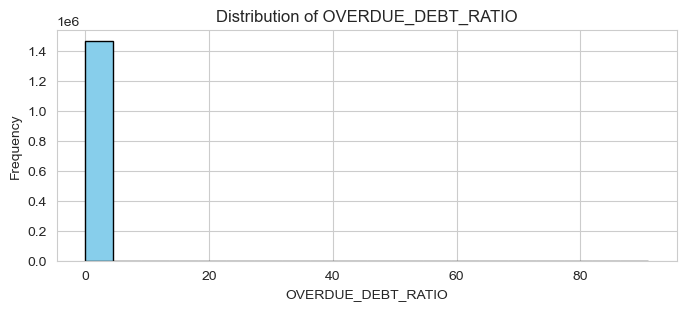

In [112]:
# The Overdue-to-Debt Ratio among Customers
customer_overdue_total = app_bureau.groupby('SK_ID_CURR')['AMT_CREDIT_SUM_OVERDUE'].sum().reset_index()
customer_debt_total = app_bureau.groupby('SK_ID_CURR')['AMT_CREDIT_SUM_DEBT'].sum().reset_index()
overdue_debt_ratio = customer_overdue_total.merge(customer_debt_total, on='SK_ID_CURR', how='left')
overdue_debt_ratio['OVERDUE_DEBT_RATIO'] = overdue_debt_ratio['AMT_CREDIT_SUM_OVERDUE'] / overdue_debt_ratio['AMT_CREDIT_SUM_DEBT']
app_bureau = app_bureau.merge(overdue_debt_ratio[['SK_ID_CURR', 'OVERDUE_DEBT_RATIO']], on='SK_ID_CURR', how='left')
app_bureau['OVERDUE_DEBT_RATIO'].fillna(0, inplace=True)
app_bureau['OVERDUE_DEBT_RATIO'] = app_bureau['OVERDUE_DEBT_RATIO'].replace([np.inf, -np.inf], 0).astype(np.float32)
# Plotting the distribution of OVERDUE_DEBT_RATIO
plt.figure(figsize=(8, 3))
plt.hist(app_bureau['OVERDUE_DEBT_RATIO'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of OVERDUE_DEBT_RATIO')
plt.xlabel('OVERDUE_DEBT_RATIO')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

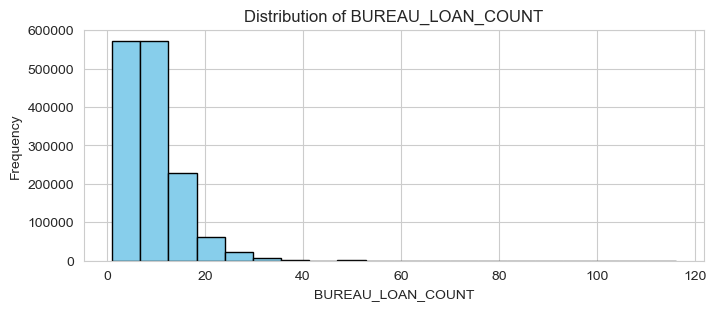

In [113]:
#Number of days between credits
app_bureau['DAYS_CREDIT'] = app_bureau['DAYS_CREDIT'].fillna(0)  # Fill missing values with 0
app_bureau['DAYS_CREDIT_interval'] = pd.cut(app_bureau['DAYS_CREDIT'], bins=[-np.inf, -365, -182, -91, 0], labels=['<1 year', '1-2 years', '2-3 years', '3+ years'])
days_credit_count = app_bureau.groupby('SK_ID_CURR')['DAYS_CREDIT_interval'].value_counts().unstack().fillna(0).reset_index().rename(columns={np.nan: 'Unknown'})
days_credit_count.columns = ['SK_ID_CURR'] + ['DAYS_CREDIT_interval_' + str(col) for col in days_credit_count.columns[1:]]
app_bureau = app_bureau.merge(days_credit_count, on='SK_ID_CURR', how='left')
app_bureau.drop(columns=['DAYS_CREDIT_interval'],inplace=True)
# Plotting the distribution of DAYS_CREDIT_COUNT
plt.figure(figsize=(8, 3))
plt.hist(app_bureau['BUREAU_LOAN_COUNT'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of BUREAU_LOAN_COUNT')
plt.xlabel('BUREAU_LOAN_COUNT')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()
# Plot
# fig, axes = plt.subplots(2, 2, figsize=(12, 8))
# intervals = ['<1 year', '1-2 years', '2-3 years', '3+ years']
# for i, interval in enumerate(intervals):
#     row = i // 2
#     col = i % 2
#     ax = axes[row, col]
#     ax.hist(app_bureau['DAYS_CREDIT_interval_' + interval], bins=20, color='skyblue', edgecolor='black')
#     ax.set_title('Count of DAYS_CREDIT in ' + interval)
#     ax.set_xlabel('Count')
#     ax.set_ylabel('Frequency')
# print(app_bureau.columns)
# plt.tight_layout()
# plt.show()

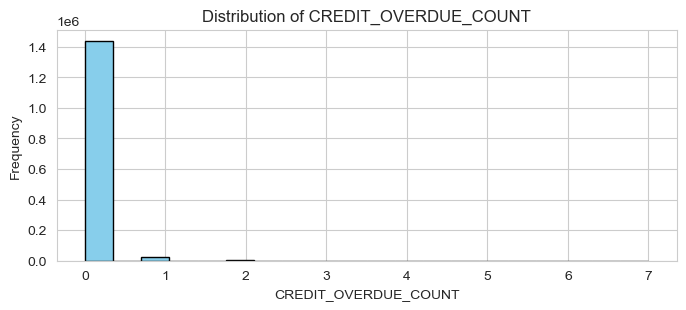

In [114]:
# Number of days a credit has been overdue
credit_overdue_count = app_bureau.groupby('SK_ID_CURR')['CREDIT_DAY_OVERDUE'].apply(lambda x: (x > 0).sum()).reset_index().rename(columns={'CREDIT_DAY_OVERDUE': 'CREDIT_OVERDUE_COUNT'})
app_bureau = app_bureau.merge(credit_overdue_count, on='SK_ID_CURR', how='left')
app_bureau['CREDIT_OVERDUE_COUNT'].fillna(0, inplace=True)
# Plotting the distribution of CREDIT_OVERDUE_COUNT
plt.figure(figsize=(8, 3))
plt.hist(app_bureau['CREDIT_OVERDUE_COUNT'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of CREDIT_OVERDUE_COUNT')
plt.xlabel('CREDIT_OVERDUE_COUNT')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

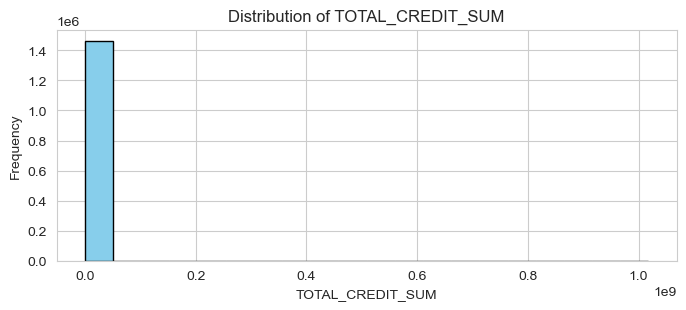

In [115]:
# Total credit amount per customer
total_credit_sum = app_bureau.groupby('SK_ID_CURR')['AMT_CREDIT_SUM'].sum().reset_index()
total_credit_sum.columns = ['SK_ID_CURR', 'TOTAL_CREDIT_SUM']
app_bureau = app_bureau.merge(total_credit_sum, on='SK_ID_CURR', how='left')
# Plotting the distribution of TOTAL_CREDIT_SUM
plt.figure(figsize=(8, 3))
plt.hist(app_bureau['TOTAL_CREDIT_SUM'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of TOTAL_CREDIT_SUM')
plt.xlabel('TOTAL_CREDIT_SUM')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

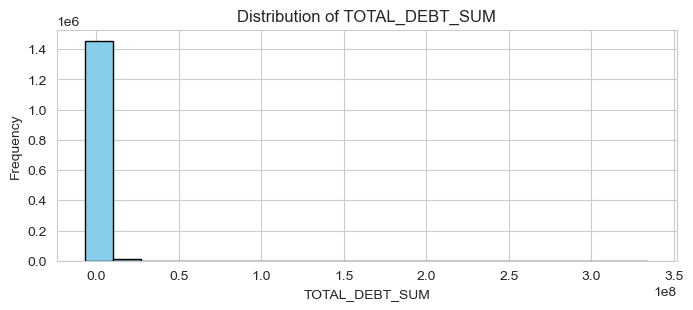

In [116]:
# Total debt amount per customer
total_debt_sum = app_bureau.groupby('SK_ID_CURR')['AMT_CREDIT_SUM_DEBT'].sum().reset_index()
total_debt_sum.columns = ['SK_ID_CURR', 'TOTAL_DEBT_SUM']
app_bureau = app_bureau.merge(total_debt_sum, on='SK_ID_CURR', how='left')
# Plotting the distribution of TOTAL_DEBT_SUM
plt.figure(figsize=(8, 3))
plt.hist(app_bureau['TOTAL_DEBT_SUM'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of TOTAL_DEBT_SUM')
plt.xlabel('TOTAL_DEBT_SUM')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

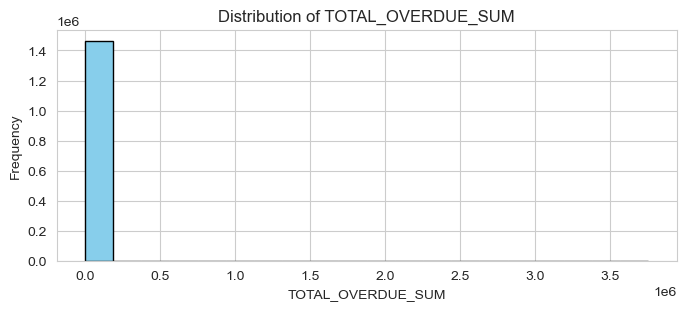

In [117]:
# Total amount overdue on credits per customer
total_overdue_sum = app_bureau.groupby('SK_ID_CURR')['AMT_CREDIT_SUM_OVERDUE'].sum().reset_index()
total_overdue_sum.columns = ['SK_ID_CURR', 'TOTAL_OVERDUE_SUM']
app_bureau = app_bureau.merge(total_overdue_sum, on='SK_ID_CURR', how='left')
# Plotting the distribution of TOTAL_OVERDUE_SUM
plt.figure(figsize=(8, 3))
plt.hist(app_bureau['TOTAL_OVERDUE_SUM'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of TOTAL_OVERDUE_SUM')
plt.xlabel('TOTAL_OVERDUE_SUM')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

###  app_bureau_final is my Final DataFrame , lets suffle the records within the dataframe.

In [118]:
app_bureau_final = app_bureau.sample(frac=1, random_state=42).reset_index(drop=True)

### Preprocessing :  Train/Test Split and Features Scaling - Standard Scaler.  


In [119]:
y = app_bureau_final['TARGET'].values.reshape(-1,1)
X = app_bureau_final.drop(columns=['TARGET', 'SK_ID_CURR'])
print(X.shape, y.shape)

(1465325, 76) (1465325, 1)


In [120]:
# Split the data into train and test sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=42)

In [121]:
# Display the Shape of the feature Variables
print('Shape of X_train:', X_train.shape)
print('Shape of X_test:', X_test.shape)
print('Shape of y_train:', y_train.shape)
print('Shape of y_test:', y_test.shape) 

Shape of X_train: (1025727, 76)
Shape of X_test: (439598, 76)
Shape of y_train: (1025727, 1)
Shape of y_test: (439598, 1)


In [122]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X_train)
# Transform the training and test data
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [123]:
print(len(X_train.columns.to_list()))

76


###### As we see from above , we have 76 features in the merged application data with Bureau data, lets apply Feature Selection Techniques to find the most important features - ex: less features so that we can apply training with minimal required features.

## Feature Selection Techniques 

In [124]:
num_features = 50  # Let's start with Selecting 50 Top Features 

#### Let's use F-Score to Select the feature - The F-score is used in feature selection to assess the relationship between each feature and the target variable

In [125]:
from sklearn.feature_selection import SelectKBest, f_classif

def features_selection_f_score(k=20):
    feature_selector = SelectKBest(score_func=f_classif, k=k)
    feature_selector.fit(X_train_scaled, y_train)
    selected_feature_indices = list(feature_selector.get_support(indices=True))
    selected_features = X_train.columns[selected_feature_indices]
    return selected_feature_indices, selected_features

In [126]:
selected_feature_indices, selected_features = features_selection_f_score(num_features)
print(f"Selected Features : {selected_features} and Indices: {selected_feature_indices}")

Selected Features : Index(['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'CNT_CHILDREN',
       'AMT_CREDIT', 'AMT_GOODS_PRICE', 'NAME_INCOME_TYPE',
       'NAME_EDUCATION_TYPE', 'NAME_HOUSING_TYPE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OCCUPATION_TYPE',
       'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'LIVE_CITY_NOT_WORK_CITY', 'ORGANIZATION_TYPE',
       'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_YEAR', 'AGE_Group',
       'ANNUITY_INCOME_PERCENTAGE', 'CREDIT_TERM', 'DAYS_EMPLOYED_PERCENTAGE',
       'CREDIT_ACTIVE', 'DAYS_CREDIT', 'DAYS_CREDIT_ENDDATE',
       'DAYS_ENDDATE_FACT', 'AMT_CREDIT_SUM', 'CREDIT_TYPE',
       'DAYS_CREDIT_UPD

#### Generic Functions for Plotting RoC/AUC and Model Evaluation for classification algorigthms


In [127]:
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc, roc_auc_score

def plot_auc(y_test, y_pred_proba):
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    roc_auc = auc(fpr, tpr)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('FalsePositive Rate')
    plt.ylabel('TruePositive Rate')
    plt.title('ReceiverOperatingCharacteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.show()

def model_evaluation(y_test, y_pred_binary,y_pred_proba ):
    # Evaluate the model
    accuracy = accuracy_score(y_test, y_pred_binary)
    print("Accuracy:", accuracy)

    plot_auc(y_test, y_pred_proba)

    # Print classification report
    print("Classification Report:")
    print(classification_report(y_test, y_pred_binary))

    # Print confusion matrix
    print("Confusion Matrix:")
    print(confusion_matrix(y_test, y_pred_binary))


### Build Binary Classification Model with LogisticRegression 

Accuracy: 0.9219718925017857


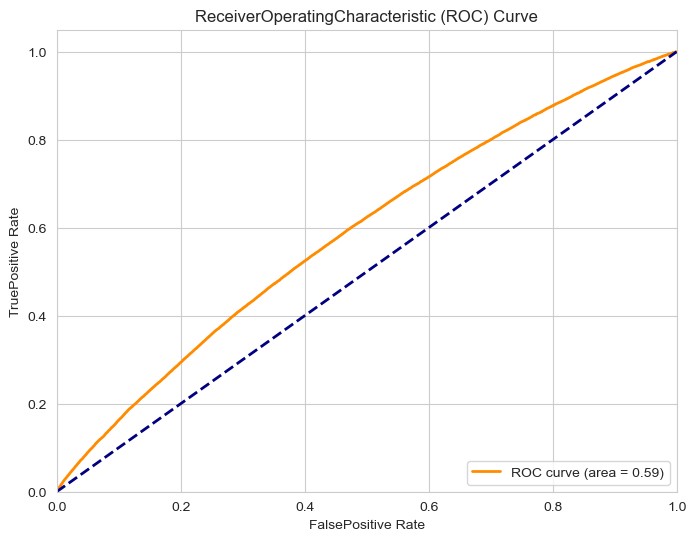

Classification Report:
              precision    recall  f1-score   support

           0       0.92      1.00      0.96    405305
           1       0.25      0.00      0.00     34293

    accuracy                           0.92    439598
   macro avg       0.59      0.50      0.48    439598
weighted avg       0.87      0.92      0.88    439598

Confusion Matrix:
[[405293     12]
 [ 34289      4]]


In [128]:
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression

# Filter the dataset to include only the selected features
X_train_selected = X_train[selected_features]
X_test_selected = X_test[selected_features]

# Define the threshold for binary classification
threshold = 0.5

# Initialize a Logistic Regression classifier
log_reg_classifier = LogisticRegression()

# Create a pipeline with the imputer and the classifier
pipeline = Pipeline([ ('classifier', log_reg_classifier)])

# Train the model on the training data
pipeline.fit(X_train_selected, y_train)

# Make predictions on the test set probabilities
y_pred_proba = pipeline.predict_proba(X_test_selected)[:, 1]  # Get the probability of positive class (class 1)

# Convert probabilities to binary predictions based on the threshold
y_pred_binary = (y_pred_proba > threshold).astype(int)

# Evaluate the model
model_evaluation(y_test, y_pred_binary, y_pred_proba)

***Looking at the classification report and confusion matrix, we can see that the model's performance is skewed towards the majority class (class 0). Model is unable to correctly identify most of the positive instances.***
Hence let's build Binary classification logistic regression model with Random Over Sampler. 

### Binary Classification Model Re-build with RandomOver Sampler and LogisticRegression 


Accuracy: 0.685141879626386


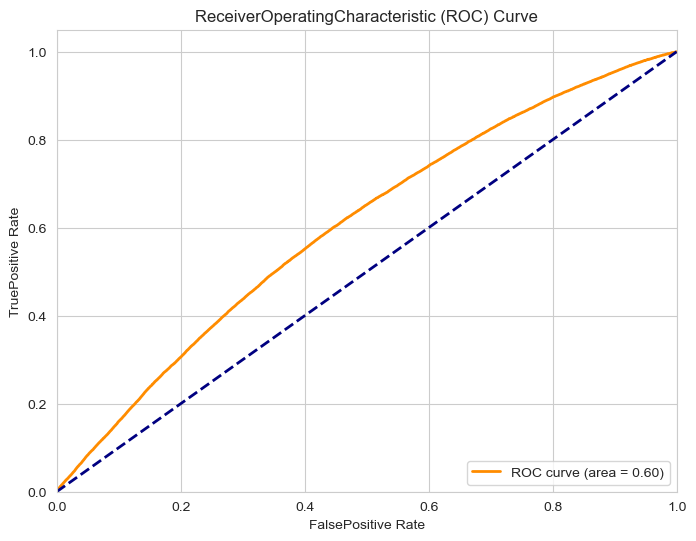

Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.71      0.81    405305
           1       0.11      0.43      0.18     34293

    accuracy                           0.69    439598
   macro avg       0.52      0.57      0.49    439598
weighted avg       0.87      0.69      0.76    439598

Confusion Matrix:
[[286466 118839]
 [ 19572  14721]]


In [129]:
from imblearn.pipeline import make_pipeline
from imblearn.over_sampling import RandomOverSampler

# # Initialize RandomOverSampler for handling class imbalance
oversampler = RandomOverSampler(random_state=42)
log_reg_classifier = LogisticRegression()
# Create a pipeline with the imputer, oversampler, and the classifier
pipeline = make_pipeline(oversampler, log_reg_classifier)

pipeline.fit(X_train_selected, y_train)

# Make predictions on the test set probabilities
y_pred_proba = pipeline.predict_proba(X_test_selected)[:, 1]  

# Convert probabilities to binary predictions based on the threshold
y_pred_binary = (y_pred_proba > threshold).astype(int)

# Evaluate the model
model_evaluation(y_test, y_pred_binary, y_pred_proba)

***We can still see that model performance is still poor and Precision for Class-1 is 11%. Though RoC is better i.e 0.60***
Hence, let's build binary classification model with RandomForestClassifier HyperParameters tuning  

### Binary Classification Model RandomForest along with Hyperparameters tuning. 

Best Hyperparameters: {'max_depth': 7, 'n_estimators': 171}
Accuracy: 0.6646299573701427


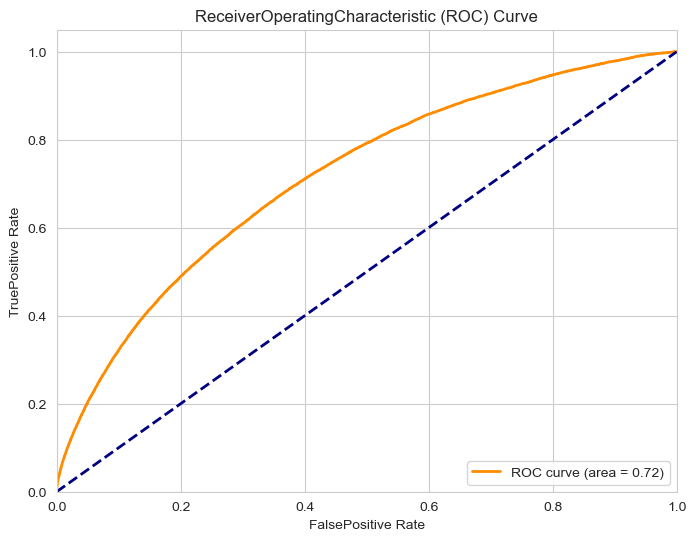

Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.67      0.79    405305
           1       0.14      0.65      0.23     34293

    accuracy                           0.66    439598
   macro avg       0.55      0.66      0.51    439598
weighted avg       0.89      0.66      0.74    439598

Confusion Matrix:
[[269993 135312]
 [ 12116  22177]]


In [130]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from scipy.stats import randint

# Define parameter grid
param_dist = {
    'n_estimators': randint(50, 300),
    'max_depth': [3, 5, 7],
}
 
clf = RandomForestClassifier(criterion='gini', class_weight='balanced', random_state=42, n_jobs=-1)

# Randomized search
random_search = RandomizedSearchCV(clf, param_distributions=param_dist, n_iter=5, cv=2, scoring='f1', random_state=42)

# Fit the model
random_search.fit(X_train_scaled[:, selected_feature_indices], y_train)

# Get the best parameters
best_params = random_search.best_params_
print("Best Hyperparameters:", best_params)

# Extract best model
best_model = random_search.best_estimator_

# Predict probabilities
y_pred_proba = best_model.predict_proba(X_test_scaled[:, selected_feature_indices])[:, 1]
threshold = 0.5

y_pred_binary = (y_pred_proba > threshold).astype(int)

# Evaluate the model
model_evaluation(y_test, y_pred_binary, y_pred_proba)

***High Precision for Loan Approvals: The model exhibits a high precision rate of 96% for loan approvals, minimizing the risk of granting loans to unqualified applicants. Balanced F1-score for Loan Approvals: With an F1-score of 74% , the model achieves a good balance between precision and recall for approved loans, ensuring reliable decision-making.he ROC curve area of 0.72 demonstrates the model's moderate ability to discriminate between loan approvals and rejections, providing valuable insights for risk assessment.*** 

### Binary Classification Model with Light Gradient Boosting  

In [131]:
import lightgbm as lgb

print(lgb.__version__)

4.3.0


[LightGBM] [Warning] Using too small ``bin_construct_sample_cnt`` may encounter unexpected errors and poor accuracy.
[LightGBM] [Info] Number of positive: 80227, number of negative: 945500
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.095627 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1253
[LightGBM] [Info] Number of data points in the train set: 1025727, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.482767 -> initscore=-0.068958
[LightGBM] [Info] Start training from score -0.068958
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] N

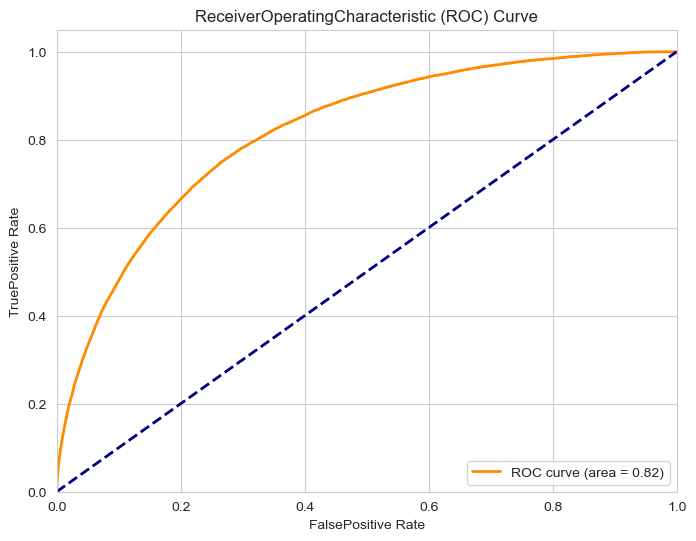

Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.77      0.86    405305
           1       0.21      0.70      0.32     34293

    accuracy                           0.77    439598
   macro avg       0.59      0.74      0.59    439598
weighted avg       0.91      0.77      0.82    439598

Confusion Matrix:
[[312809  92496]
 [ 10164  24129]]


In [132]:
import lightgbm as lgb

# Ensure y_train is 1-dimensional
y_train = np.squeeze(y_train)

# Set up weights based on class distribution
weight = np.ones(len(X_train_scaled), dtype=int)
weight[y_train == 1] = 11

# Creating train_data and valid_data
X_train_selected = X_train_scaled[:, selected_feature_indices]
X_test_selected = X_test_scaled[:, selected_feature_indices]
train_data = lgb.Dataset(X_train_selected , label=y_train, weight=weight)
valid_data = lgb.Dataset(X_test_selected , label=y_test)


# Hyperparameters and max_depths for tuning
max_depth = 5

# Define parameter grid
param_dist = {
    'boosting_type': ['gbdt'],
    'max_depth': max_depth,
    'objective': ['binary'],
    'nthread': [10],
    'num_leaves': [32],
    'learning_rate': [0.01],
    'max_bin': [512],
    'subsample_for_bin': [200],
    'subsample': [0.7],
    'subsample_freq': [1],
    'colsample_bytree': [0.8],
    'reg_alpha': [20],
    'reg_lambda': [20],
    'min_split_gain': [0.5],
    'min_child_weight': [1],
    'min_child_samples': [10],
    'scale_pos_weight': [1],
    'num_class': [1],
    'metric': ['auc']
}

lgbm = lgb.train(param_dist,
                 train_data,
                 num_boost_round=3000,
                 valid_sets=[valid_data])

# Evaluate on training set
y_pred_prob_train = lgbm.predict(X_train_selected)
print(f'Train AUC score: {roc_auc_score(y_train, y_pred_prob_train)}')

# Evaluate on test set
y_pred_proba = lgbm.predict(X_test_selected)
print(f'Test AUC score: {roc_auc_score(y_test, y_pred_proba) }')

threshold = 0.5  # Define threshold
y_pred = (y_pred_proba > threshold).astype(int)

# Evaluate the model
model_evaluation(y_test, y_pred, y_pred_proba)

**Better than previous model as Light Gradient Boosting model achieves a precision of 97% for loan approvals, minimizing the risk of granting loans to unqualified applicants.With an weighted Avg F1-score of 82%, the model maintains a good balance between precision and recall, ensuring reliable decision-making in approving loans.The ROC curve area of 82% demonstrates the model's ability to discriminate between loan approvals and rejections, providing valuable insights for risk assessment.Overall, the model's high precision, balanced F1-score, effective discrimination, and stable predictions make it a valuable tool for the bank in identifying qualified borrowers while minimizing risks associated with loan approvals.However there is still further scope to optimise the model specially for Class -1 . we can further do Hyperparameters tuning for Gradient Boosting**

### Extract the Final Factors / features influencing Borrower's Behavior from the final model


In [133]:
feature_importance = lgbm.feature_importance(importance_type='gain', iteration=-1)
# Display top influential factors
top_factors_indices = feature_importance.argsort()[::-1][:10] 
print("Top Factors Influencing Borrower's Behavior:")
print([selected_features[i] for i in top_factors_indices])

Top Factors Influencing Borrower's Behavior:
['CREDIT_TERM', 'DEBT_CREDIT_RATIO', 'DAYS_EMPLOYED', 'DAYS_BIRTH', 'TOTAL_DEBT_SUM', 'AMT_GOODS_PRICE', 'AMT_CREDIT', 'DAYS_CREDIT_interval_1-2 years', 'DAYS_CREDIT_interval_3+ years', 'DAYS_CREDIT_interval_<1 year']


### Conclusions/Recommendations  

1. Accuracy: The Final model achieved an accuracy of 76%, indicating its ability to correctly classify loan applications as approved or rejected.
With an ROC curve area of 0.82, the model demonstrates a good ability to distinguish between loan approvals and rejections.

2. Top 10 Factors Influencing Borrower Behavior:
'CREDIT_TERM'
 'DEBT_CREDIT_RATIO'
 'DAYS_EMPLOYED'
 'DAYS_BIRTH'
 'TOTAL_DEBT_SUM'
 'AMT_GOODS_PRICE'
 'AMT_CREDIT'
 'DAYS_CREDIT_interval_1-2 years'
 'DAYS_CREDIT_interval_3+ years'
 'DAYS_CREDIT_interval_<1 year'

By aggregating trade level information to the applicant level, financial institutions can gain insights into borrowers' payment behavior.
Features like 'DEBT_CREDIT_RATIO', ' 'DAYS_CREDIT_interval_*' and 'TOTAL_DEBT_SUM' from the credit bureau data contribute significantly to understanding borrowers' historical credit usage and payment patterns.

Factors such as 'CREDIT_TERM', 'AMT_CREDIT',  'AMT_GOODS_PRICE', DAYS_EMPLOYED significantly influence borrower behavior.
These features highlight aspects like loan terms, goods price affordability ratios,Employment duration/days , and debt management practices, providing insights into borrowers' financial health, age group and risk propensity. By incorporating influential factors identified from borrower behavior analysis, financial institutions can enhance their risk assessment capabilities and make informed decisions regarding loan approvals.